# Mask R-CNN - Train on Shapes Dataset


This notebook shows how to train Mask R-CNN on your own dataset. To keep things simple we use a synthetic dataset of shapes (squares, triangles, and circles) which enables fast training. You'd still need a GPU, though, because the network backbone is a Resnet101, which would be too slow to train on a CPU. On a GPU, you can start to get okay-ish results in a few minutes, and good results in less than an hour.

The code of the *Shapes* dataset is included below. It generates images on the fly, so it doesn't require downloading any data. And it can generate images of any size, so we pick a small image size to train faster. 

In [1]:
import os
import sys
import random
import math
import re
import time
import numpy as np
import cv2
import matplotlib
import matplotlib.pyplot as plt

# Root directory of the project
ROOT_DIR = os.getcwd()

# Import Mask RCNN
sys.path.append(ROOT_DIR)  # To find local version of the library
from mrcnn.config import Config
from mrcnn import utils
import mrcnn.model as modellib
from mrcnn import visualize
from mrcnn.model import log

%matplotlib inline 

# Directory to save logs and trained model
MODEL_DIR = os.path.join(ROOT_DIR, "logs")

# Local path to trained weights file
COCO_MODEL_PATH = os.path.join(ROOT_DIR, "mask_rcnn_coco.h5")
# Download COCO trained weights from Releases if needed
if not os.path.exists(COCO_MODEL_PATH):
    utils.download_trained_weights(COCO_MODEL_PATH)

Using TensorFlow backend.


## Configurations

In [2]:
import custom 
print(ROOT_DIR)
config = custom.CustomConfig()
custom_DIR = os.path.join(ROOT_DIR, "customImages")


# Override the training configurations with a few
# changes for inferencing.
class InferenceConfig(config.__class__):
    # Run detection on one image at a time
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1

config = InferenceConfig()
config.display()

C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master

Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.9
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                14
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn

## Notebook Preferences

In [3]:
# Device to load the neural network on.
# Useful if you're training a model on the same 
# machine, in which case use CPU and leave the
# GPU for training.
DEVICE = "/cpu:0"  # /cpu:0 or /gpu:0

# Inspect the model in training or inference modes
# values: 'inference' or 'training'
# TODO: code for 'training' test mode not ready yet
TEST_MODE = "inference"

def get_ax(rows=1, cols=1, size=16):
    """Return a Matplotlib Axes array to be used in
    all visualizations in the notebook. Provide a
    central point to control graph sizes.
    
    Adjust the size attribute to control how big to render images
    """
    _, ax = plt.subplots(rows, cols, figsize=(size*cols, size*rows))
    return ax

## Dataset

Create a synthetic dataset

Extend the Dataset class and add a method to load the shapes dataset, `load_shapes()`, and override the following methods:

* load_image()
* load_mask()
* image_reference()

In [4]:
# Training dataset
dataset_train = custom.CustomDataset()
dataset_train.load_custom(custom_DIR, "train")
dataset_train.prepare()

# Validation dataset
dataset_val = custom.CustomDataset()
dataset_val.load_custom(custom_DIR, "val")
dataset_val.prepare()

print(dataset_train)
print(dataset_val)

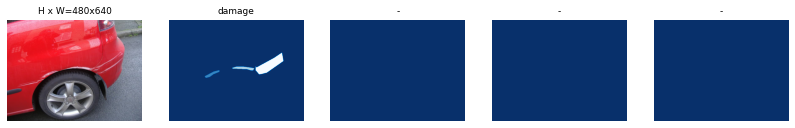

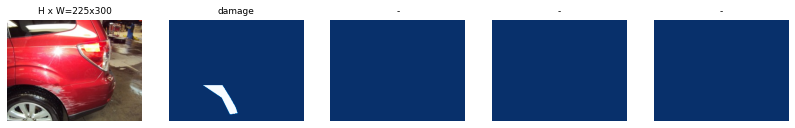

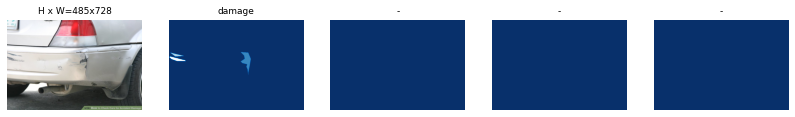

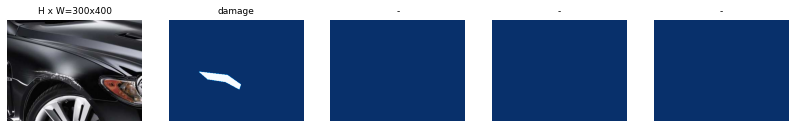

In [5]:
# Load and display random samples
image_ids = np.random.choice(dataset_train.image_ids, 4)
for image_id in image_ids:
    image = dataset_train.load_image(image_id)
    mask, class_ids = dataset_train.load_mask(image_id)
    visualize.display_top_masks(image, mask, class_ids, dataset_train.class_names)

## Create Model

In [6]:
# Create model in training mode
model = modellib.MaskRCNN(mode="training", config=config,
                          model_dir=MODEL_DIR)








Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Instructions for updating:
box_ind is deprecated, use box_indices instead


In [7]:
# Which weights to start with?
init_with = "coco"  # imagenet, coco, or last

if init_with == "imagenet":
    model.load_weights(model.get_imagenet_weights(), by_name=True)
elif init_with == "coco":
    # Load weights trained on MS COCO, but skip layers that
    # are different due to the different number of classes
    # See README for instructions to download the COCO weights
    model.load_weights(COCO_MODEL_PATH, by_name=True,
                       exclude=["mrcnn_class_logits", "mrcnn_bbox_fc", 
                                "mrcnn_bbox", "mrcnn_mask"])
elif init_with == "last":
    # Load the last model you trained and continue training
    model.load_weights(model.find_last(), by_name=True)

## Training

Train in two stages:
1. Only the heads. Here we're freezing all the backbone layers and training only the randomly initialized layers (i.e. the ones that we didn't use pre-trained weights from MS COCO). To train only the head layers, pass `layers='heads'` to the `train()` function.

2. Fine-tune all layers. For this simple example it's not necessary, but we're including it to show the process. Simply pass `layers="all` to train all layers.

In [8]:
# Train the head branches
# Passing layers="heads" freezes all layers except the head
# layers. You can also pass a regular expression to select
# which layers to train by name pattern.
model.train(dataset_train, dataset_val, 
            learning_rate=config.LEARNING_RATE, 
            epochs=1, 
            layers='heads')


Starting at epoch 0. LR=0.001

Checkpoint Path: C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\logs\damage20201119T1856\mask_rcnn_damage_{epoch:04d}.h5
Selecting layers to train
fpn_c5p5               (Conv2D)
fpn_c4p4               (Conv2D)
fpn_c3p3               (Conv2D)
fpn_c2p2               (Conv2D)
fpn_p5                 (Conv2D)
fpn_p2                 (Conv2D)
fpn_p3                 (Conv2D)
fpn_p4                 (Conv2D)
In model:  rpn_model
    rpn_conv_shared        (Conv2D)
    rpn_class_raw          (Conv2D)
    rpn_bbox_pred          (Conv2D)
mrcnn_mask_conv1       (TimeDistributed)
mrcnn_mask_bn1         (TimeDistributed)
mrcnn_mask_conv2       (TimeDistributed)
mrcnn_mask_bn2         (TimeDistributed)
mrcnn_class_conv1      (TimeDistributed)
mrcnn_class_bn1        (TimeDistributed)
mrcnn_mask_conv3       (TimeDistributed)
mrcnn_mask_bn3         (TimeDistributed)
mrcnn_class_conv2      (TimeDistributed)
mrcnn_class_bn2        (TimeDistributed)
mr

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\tensorflow_core\python\framework\indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\tensorflow_core\python\framework\indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\tensorflow_core\python\framework\indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of 





Epoch 1/1


c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  1/100 [..............................] - ETA: 1:35:36 - loss: 1.4801 - rpn_class_loss: 0.3720 - rpn_bbox_loss: 0.8097 - mrcnn_class_loss: 0.2984 - mrcnn_bbox_loss: 0.0000e+00 - mrcnn_mask_loss: 0.0000e+00

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  2/100 [..............................] - ETA: 1:16:44 - loss: 4.6029 - rpn_class_loss: 0.2864 - rpn_bbox_loss: 4.1186 - mrcnn_class_loss: 0.1979 - mrcnn_bbox_loss: 0.0000e+00 - mrcnn_mask_loss: 0.0000e+00

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  3/100 [..............................] - ETA: 1:09:53 - loss: 4.2739 - rpn_class_loss: 0.2115 - rpn_bbox_loss: 3.9201 - mrcnn_class_loss: 0.1423 - mrcnn_bbox_loss: 0.0000e+00 - mrcnn_mask_loss: 0.0000e+00

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  4/100 [>.............................] - ETA: 1:06:25 - loss: 4.5543 - rpn_class_loss: 0.1655 - rpn_bbox_loss: 3.2639 - mrcnn_class_loss: 0.1190 - mrcnn_bbox_loss: 0.4484 - mrcnn_mask_loss: 0.5575        

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  5/100 [>.............................] - ETA: 1:04:40 - loss: 4.6464 - rpn_class_loss: 0.1378 - rpn_bbox_loss: 2.9207 - mrcnn_class_loss: 0.1621 - mrcnn_bbox_loss: 0.8399 - mrcnn_mask_loss: 0.5860

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  6/100 [>.............................] - ETA: 1:02:48 - loss: 4.3416 - rpn_class_loss: 0.1250 - rpn_bbox_loss: 2.5106 - mrcnn_class_loss: 0.1625 - mrcnn_bbox_loss: 0.8711 - mrcnn_mask_loss: 0.6723

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  7/100 [=>............................] - ETA: 1:01:24 - loss: 4.6883 - rpn_class_loss: 0.1381 - rpn_bbox_loss: 3.0879 - mrcnn_class_loss: 0.1393 - mrcnn_bbox_loss: 0.7467 - mrcnn_mask_loss: 0.5763

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  8/100 [=>............................] - ETA: 1:00:22 - loss: 4.8222 - rpn_class_loss: 0.1462 - rpn_bbox_loss: 3.3965 - mrcnn_class_loss: 0.1219 - mrcnn_bbox_loss: 0.6533 - mrcnn_mask_loss: 0.5042

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  9/100 [=>............................] - ETA: 58:43 - loss: 4.5868 - rpn_class_loss: 0.1442 - rpn_bbox_loss: 3.0582 - mrcnn_class_loss: 0.1350 - mrcnn_bbox_loss: 0.6913 - mrcnn_mask_loss: 0.5581  

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 10/100 [==>...........................] - ETA: 57:59 - loss: 4.4511 - rpn_class_loss: 0.1300 - rpn_bbox_loss: 2.8842 - mrcnn_class_loss: 0.1256 - mrcnn_bbox_loss: 0.7054 - mrcnn_mask_loss: 0.6059

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 11/100 [==>...........................] - ETA: 57:05 - loss: 4.3338 - rpn_class_loss: 0.1229 - rpn_bbox_loss: 2.9046 - mrcnn_class_loss: 0.1142 - mrcnn_bbox_loss: 0.6413 - mrcnn_mask_loss: 0.5508

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 12/100 [==>...........................] - ETA: 56:08 - loss: 4.1966 - rpn_class_loss: 0.1127 - rpn_bbox_loss: 2.7000 - mrcnn_class_loss: 0.1075 - mrcnn_bbox_loss: 0.7073 - mrcnn_mask_loss: 0.5691

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 13/100 [==>...........................] - ETA: 55:09 - loss: 4.1175 - rpn_class_loss: 0.1173 - rpn_bbox_loss: 2.6179 - mrcnn_class_loss: 0.1076 - mrcnn_bbox_loss: 0.7037 - mrcnn_mask_loss: 0.5709

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 14/100 [===>..........................] - ETA: 54:23 - loss: 4.1090 - rpn_class_loss: 0.1198 - rpn_bbox_loss: 2.5720 - mrcnn_class_loss: 0.1025 - mrcnn_bbox_loss: 0.7328 - mrcnn_mask_loss: 0.5818

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 15/100 [===>..........................] - ETA: 53:36 - loss: 4.1107 - rpn_class_loss: 0.1362 - rpn_bbox_loss: 2.5356 - mrcnn_class_loss: 0.1201 - mrcnn_bbox_loss: 0.7344 - mrcnn_mask_loss: 0.5843

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 16/100 [===>..........................] - ETA: 52:48 - loss: 4.0686 - rpn_class_loss: 0.1287 - rpn_bbox_loss: 2.4246 - mrcnn_class_loss: 0.1139 - mrcnn_bbox_loss: 0.8154 - mrcnn_mask_loss: 0.5861

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 17/100 [====>.........................] - ETA: 52:14 - loss: 3.9182 - rpn_class_loss: 0.1215 - rpn_bbox_loss: 2.3380 - mrcnn_class_loss: 0.1075 - mrcnn_bbox_loss: 0.7750 - mrcnn_mask_loss: 0.5761

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 18/100 [====>.........................] - ETA: 51:46 - loss: 3.9298 - rpn_class_loss: 0.1221 - rpn_bbox_loss: 2.3247 - mrcnn_class_loss: 0.1227 - mrcnn_bbox_loss: 0.7884 - mrcnn_mask_loss: 0.5719

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 19/100 [====>.........................] - ETA: 50:59 - loss: 3.8908 - rpn_class_loss: 0.1169 - rpn_bbox_loss: 2.2456 - mrcnn_class_loss: 0.1324 - mrcnn_bbox_loss: 0.8225 - mrcnn_mask_loss: 0.5735

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 20/100 [=====>........................] - ETA: 50:34 - loss: 3.8426 - rpn_class_loss: 0.1132 - rpn_bbox_loss: 2.1980 - mrcnn_class_loss: 0.1325 - mrcnn_bbox_loss: 0.8271 - mrcnn_mask_loss: 0.5718

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 21/100 [=====>........................] - ETA: 49:53 - loss: 3.7650 - rpn_class_loss: 0.1081 - rpn_bbox_loss: 2.1009 - mrcnn_class_loss: 0.1340 - mrcnn_bbox_loss: 0.8528 - mrcnn_mask_loss: 0.5692

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 22/100 [=====>........................] - ETA: 49:10 - loss: 3.8643 - rpn_class_loss: 0.1199 - rpn_bbox_loss: 2.2176 - mrcnn_class_loss: 0.1293 - mrcnn_bbox_loss: 0.8327 - mrcnn_mask_loss: 0.5648

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 23/100 [=====>........................] - ETA: 48:23 - loss: 4.0049 - rpn_class_loss: 0.1231 - rpn_bbox_loss: 2.3353 - mrcnn_class_loss: 0.1358 - mrcnn_bbox_loss: 0.8508 - mrcnn_mask_loss: 0.5600

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 24/100 [======>.......................] - ETA: 47:28 - loss: 3.9322 - rpn_class_loss: 0.1181 - rpn_bbox_loss: 2.2608 - mrcnn_class_loss: 0.1355 - mrcnn_bbox_loss: 0.8566 - mrcnn_mask_loss: 0.5612

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 25/100 [======>.......................] - ETA: 46:30 - loss: 3.8940 - rpn_class_loss: 0.1204 - rpn_bbox_loss: 2.2209 - mrcnn_class_loss: 0.1344 - mrcnn_bbox_loss: 0.8564 - mrcnn_mask_loss: 0.5618

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 26/100 [======>.......................] - ETA: 45:34 - loss: 4.0342 - rpn_class_loss: 0.1350 - rpn_bbox_loss: 2.3490 - mrcnn_class_loss: 0.1323 - mrcnn_bbox_loss: 0.8596 - mrcnn_mask_loss: 0.5584

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 27/100 [=======>......................] - ETA: 44:42 - loss: 3.9672 - rpn_class_loss: 0.1304 - rpn_bbox_loss: 2.2870 - mrcnn_class_loss: 0.1312 - mrcnn_bbox_loss: 0.8637 - mrcnn_mask_loss: 0.5548

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 28/100 [=======>......................] - ETA: 43:54 - loss: 3.8990 - rpn_class_loss: 0.1305 - rpn_bbox_loss: 2.2146 - mrcnn_class_loss: 0.1324 - mrcnn_bbox_loss: 0.8645 - mrcnn_mask_loss: 0.5571

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 29/100 [=======>......................] - ETA: 43:04 - loss: 3.8472 - rpn_class_loss: 0.1291 - rpn_bbox_loss: 2.1590 - mrcnn_class_loss: 0.1381 - mrcnn_bbox_loss: 0.8629 - mrcnn_mask_loss: 0.5581

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 30/100 [========>.....................] - ETA: 42:16 - loss: 3.7868 - rpn_class_loss: 0.1250 - rpn_bbox_loss: 2.1046 - mrcnn_class_loss: 0.1377 - mrcnn_bbox_loss: 0.8650 - mrcnn_mask_loss: 0.5545

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 31/100 [========>.....................] - ETA: 41:29 - loss: 3.7305 - rpn_class_loss: 0.1214 - rpn_bbox_loss: 2.0628 - mrcnn_class_loss: 0.1378 - mrcnn_bbox_loss: 0.8599 - mrcnn_mask_loss: 0.5486

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 32/100 [========>.....................] - ETA: 40:43 - loss: 3.6857 - rpn_class_loss: 0.1183 - rpn_bbox_loss: 2.0124 - mrcnn_class_loss: 0.1351 - mrcnn_bbox_loss: 0.8656 - mrcnn_mask_loss: 0.5543

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 33/100 [========>.....................] - ETA: 39:57 - loss: 3.7221 - rpn_class_loss: 0.1163 - rpn_bbox_loss: 2.0485 - mrcnn_class_loss: 0.1328 - mrcnn_bbox_loss: 0.8720 - mrcnn_mask_loss: 0.5525

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 34/100 [=========>....................] - ETA: 39:13 - loss: 3.6913 - rpn_class_loss: 0.1138 - rpn_bbox_loss: 2.0011 - mrcnn_class_loss: 0.1305 - mrcnn_bbox_loss: 0.8956 - mrcnn_mask_loss: 0.5503

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 35/100 [=========>....................] - ETA: 38:29 - loss: 3.6358 - rpn_class_loss: 0.1112 - rpn_bbox_loss: 1.9561 - mrcnn_class_loss: 0.1278 - mrcnn_bbox_loss: 0.8927 - mrcnn_mask_loss: 0.5481

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 36/100 [=========>....................] - ETA: 37:45 - loss: 3.6964 - rpn_class_loss: 0.1241 - rpn_bbox_loss: 2.0473 - mrcnn_class_loss: 0.1243 - mrcnn_bbox_loss: 0.8679 - mrcnn_mask_loss: 0.5328

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 37/100 [==========>...................] - ETA: 37:03 - loss: 3.6572 - rpn_class_loss: 0.1210 - rpn_bbox_loss: 2.0079 - mrcnn_class_loss: 0.1222 - mrcnn_bbox_loss: 0.8725 - mrcnn_mask_loss: 0.5336

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 38/100 [==========>...................] - ETA: 36:24 - loss: 3.6283 - rpn_class_loss: 0.1209 - rpn_bbox_loss: 1.9686 - mrcnn_class_loss: 0.1226 - mrcnn_bbox_loss: 0.8816 - mrcnn_mask_loss: 0.5346

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 39/100 [==========>...................] - ETA: 35:44 - loss: 3.5810 - rpn_class_loss: 0.1179 - rpn_bbox_loss: 1.9208 - mrcnn_class_loss: 0.1231 - mrcnn_bbox_loss: 0.8799 - mrcnn_mask_loss: 0.5393

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 40/100 [===========>..................] - ETA: 35:03 - loss: 3.5389 - rpn_class_loss: 0.1167 - rpn_bbox_loss: 1.8844 - mrcnn_class_loss: 0.1248 - mrcnn_bbox_loss: 0.8736 - mrcnn_mask_loss: 0.5394

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 41/100 [===========>..................] - ETA: 34:25 - loss: 3.4883 - rpn_class_loss: 0.1172 - rpn_bbox_loss: 1.8435 - mrcnn_class_loss: 0.1241 - mrcnn_bbox_loss: 0.8646 - mrcnn_mask_loss: 0.5389

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 42/100 [===========>..................] - ETA: 33:47 - loss: 3.4383 - rpn_class_loss: 0.1153 - rpn_bbox_loss: 1.8054 - mrcnn_class_loss: 0.1220 - mrcnn_bbox_loss: 0.8559 - mrcnn_mask_loss: 0.5397

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 43/100 [===========>..................] - ETA: 33:09 - loss: 3.3904 - rpn_class_loss: 0.1160 - rpn_bbox_loss: 1.7921 - mrcnn_class_loss: 0.1191 - mrcnn_bbox_loss: 0.8360 - mrcnn_mask_loss: 0.5271

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 44/100 [============>.................] - ETA: 32:34 - loss: 3.3621 - rpn_class_loss: 0.1137 - rpn_bbox_loss: 1.7661 - mrcnn_class_loss: 0.1172 - mrcnn_bbox_loss: 0.8395 - mrcnn_mask_loss: 0.5256

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 45/100 [============>.................] - ETA: 31:58 - loss: 3.3446 - rpn_class_loss: 0.1121 - rpn_bbox_loss: 1.7388 - mrcnn_class_loss: 0.1182 - mrcnn_bbox_loss: 0.8468 - mrcnn_mask_loss: 0.5287

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 46/100 [============>.................] - ETA: 31:24 - loss: 3.3245 - rpn_class_loss: 0.1099 - rpn_bbox_loss: 1.7113 - mrcnn_class_loss: 0.1184 - mrcnn_bbox_loss: 0.8563 - mrcnn_mask_loss: 0.5285

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 47/100 [=============>................] - ETA: 30:49 - loss: 3.2947 - rpn_class_loss: 0.1079 - rpn_bbox_loss: 1.6891 - mrcnn_class_loss: 0.1180 - mrcnn_bbox_loss: 0.8523 - mrcnn_mask_loss: 0.5273

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 48/100 [=============>................] - ETA: 30:25 - loss: 3.2697 - rpn_class_loss: 0.1060 - rpn_bbox_loss: 1.6618 - mrcnn_class_loss: 0.1213 - mrcnn_bbox_loss: 0.8535 - mrcnn_mask_loss: 0.5271

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 49/100 [=============>................] - ETA: 29:51 - loss: 3.2685 - rpn_class_loss: 0.1081 - rpn_bbox_loss: 1.6573 - mrcnn_class_loss: 0.1225 - mrcnn_bbox_loss: 0.8551 - mrcnn_mask_loss: 0.5255

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 50/100 [==============>...............] - ETA: 29:14 - loss: 3.2383 - rpn_class_loss: 0.1070 - rpn_bbox_loss: 1.6304 - mrcnn_class_loss: 0.1212 - mrcnn_bbox_loss: 0.8522 - mrcnn_mask_loss: 0.5274

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 51/100 [==============>...............] - ETA: 28:36 - loss: 3.2260 - rpn_class_loss: 0.1082 - rpn_bbox_loss: 1.6241 - mrcnn_class_loss: 0.1236 - mrcnn_bbox_loss: 0.8440 - mrcnn_mask_loss: 0.5261

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 52/100 [==============>...............] - ETA: 27:58 - loss: 3.2077 - rpn_class_loss: 0.1074 - rpn_bbox_loss: 1.6064 - mrcnn_class_loss: 0.1262 - mrcnn_bbox_loss: 0.8428 - mrcnn_mask_loss: 0.5249

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 53/100 [==============>...............] - ETA: 27:22 - loss: 3.1744 - rpn_class_loss: 0.1071 - rpn_bbox_loss: 1.5805 - mrcnn_class_loss: 0.1250 - mrcnn_bbox_loss: 0.8392 - mrcnn_mask_loss: 0.5226

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 54/100 [===============>..............] - ETA: 26:46 - loss: 3.1631 - rpn_class_loss: 0.1072 - rpn_bbox_loss: 1.5614 - mrcnn_class_loss: 0.1302 - mrcnn_bbox_loss: 0.8410 - mrcnn_mask_loss: 0.5234

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 55/100 [===============>..............] - ETA: 26:12 - loss: 3.1363 - rpn_class_loss: 0.1060 - rpn_bbox_loss: 1.5343 - mrcnn_class_loss: 0.1295 - mrcnn_bbox_loss: 0.8451 - mrcnn_mask_loss: 0.5215

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 56/100 [===============>..............] - ETA: 25:34 - loss: 3.1054 - rpn_class_loss: 0.1042 - rpn_bbox_loss: 1.5108 - mrcnn_class_loss: 0.1290 - mrcnn_bbox_loss: 0.8400 - mrcnn_mask_loss: 0.5214

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 57/100 [================>.............] - ETA: 24:57 - loss: 3.0850 - rpn_class_loss: 0.1027 - rpn_bbox_loss: 1.4886 - mrcnn_class_loss: 0.1303 - mrcnn_bbox_loss: 0.8407 - mrcnn_mask_loss: 0.5227

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 58/100 [================>.............] - ETA: 24:21 - loss: 3.0569 - rpn_class_loss: 0.1013 - rpn_bbox_loss: 1.4655 - mrcnn_class_loss: 0.1298 - mrcnn_bbox_loss: 0.8392 - mrcnn_mask_loss: 0.5212

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 59/100 [================>.............] - ETA: 23:45 - loss: 3.0397 - rpn_class_loss: 0.1000 - rpn_bbox_loss: 1.4449 - mrcnn_class_loss: 0.1305 - mrcnn_bbox_loss: 0.8398 - mrcnn_mask_loss: 0.5246

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 60/100 [=================>............] - ETA: 23:08 - loss: 3.0227 - rpn_class_loss: 0.0994 - rpn_bbox_loss: 1.4260 - mrcnn_class_loss: 0.1335 - mrcnn_bbox_loss: 0.8376 - mrcnn_mask_loss: 0.5263

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 61/100 [=================>............] - ETA: 22:31 - loss: 2.9960 - rpn_class_loss: 0.0984 - rpn_bbox_loss: 1.4034 - mrcnn_class_loss: 0.1323 - mrcnn_bbox_loss: 0.8360 - mrcnn_mask_loss: 0.5259

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 62/100 [=================>............] - ETA: 21:54 - loss: 2.9791 - rpn_class_loss: 0.0971 - rpn_bbox_loss: 1.3857 - mrcnn_class_loss: 0.1316 - mrcnn_bbox_loss: 0.8396 - mrcnn_mask_loss: 0.5251

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 63/100 [=================>............] - ETA: 21:19 - loss: 2.9581 - rpn_class_loss: 0.0957 - rpn_bbox_loss: 1.3702 - mrcnn_class_loss: 0.1316 - mrcnn_bbox_loss: 0.8365 - mrcnn_mask_loss: 0.5240

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 64/100 [==================>...........] - ETA: 20:43 - loss: 2.9374 - rpn_class_loss: 0.0943 - rpn_bbox_loss: 1.3571 - mrcnn_class_loss: 0.1303 - mrcnn_bbox_loss: 0.8325 - mrcnn_mask_loss: 0.5232

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 65/100 [==================>...........] - ETA: 20:10 - loss: 2.9310 - rpn_class_loss: 0.0936 - rpn_bbox_loss: 1.3485 - mrcnn_class_loss: 0.1287 - mrcnn_bbox_loss: 0.8383 - mrcnn_mask_loss: 0.5220

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 66/100 [==================>...........] - ETA: 19:36 - loss: 2.9136 - rpn_class_loss: 0.0927 - rpn_bbox_loss: 1.3323 - mrcnn_class_loss: 0.1279 - mrcnn_bbox_loss: 0.8333 - mrcnn_mask_loss: 0.5272

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 67/100 [===================>..........] - ETA: 19:03 - loss: 2.8805 - rpn_class_loss: 0.0941 - rpn_bbox_loss: 1.3201 - mrcnn_class_loss: 0.1260 - mrcnn_bbox_loss: 0.8209 - mrcnn_mask_loss: 0.5194

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 68/100 [===================>..........] - ETA: 18:28 - loss: 2.8615 - rpn_class_loss: 0.0931 - rpn_bbox_loss: 1.3046 - mrcnn_class_loss: 0.1252 - mrcnn_bbox_loss: 0.8205 - mrcnn_mask_loss: 0.5180

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 69/100 [===================>..........] - ETA: 17:54 - loss: 2.8444 - rpn_class_loss: 0.0919 - rpn_bbox_loss: 1.2920 - mrcnn_class_loss: 0.1257 - mrcnn_bbox_loss: 0.8186 - mrcnn_mask_loss: 0.5163

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 70/100 [====================>.........] - ETA: 17:20 - loss: 2.8328 - rpn_class_loss: 0.0910 - rpn_bbox_loss: 1.2794 - mrcnn_class_loss: 0.1254 - mrcnn_bbox_loss: 0.8207 - mrcnn_mask_loss: 0.5163

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 71/100 [====================>.........] - ETA: 16:45 - loss: 2.8231 - rpn_class_loss: 0.0902 - rpn_bbox_loss: 1.2697 - mrcnn_class_loss: 0.1267 - mrcnn_bbox_loss: 0.8199 - mrcnn_mask_loss: 0.5166

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 72/100 [====================>.........] - ETA: 16:11 - loss: 2.8065 - rpn_class_loss: 0.0899 - rpn_bbox_loss: 1.2593 - mrcnn_class_loss: 0.1268 - mrcnn_bbox_loss: 0.8159 - mrcnn_mask_loss: 0.5145

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 73/100 [====================>.........] - ETA: 15:37 - loss: 2.7878 - rpn_class_loss: 0.0888 - rpn_bbox_loss: 1.2469 - mrcnn_class_loss: 0.1255 - mrcnn_bbox_loss: 0.8112 - mrcnn_mask_loss: 0.5154

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 74/100 [=====================>........] - ETA: 15:03 - loss: 2.7741 - rpn_class_loss: 0.0883 - rpn_bbox_loss: 1.2337 - mrcnn_class_loss: 0.1279 - mrcnn_bbox_loss: 0.8095 - mrcnn_mask_loss: 0.5147

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 75/100 [=====================>........] - ETA: 14:29 - loss: 2.7584 - rpn_class_loss: 0.0876 - rpn_bbox_loss: 1.2216 - mrcnn_class_loss: 0.1273 - mrcnn_bbox_loss: 0.8080 - mrcnn_mask_loss: 0.5138

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 76/100 [=====================>........] - ETA: 13:55 - loss: 2.7441 - rpn_class_loss: 0.0875 - rpn_bbox_loss: 1.2089 - mrcnn_class_loss: 0.1286 - mrcnn_bbox_loss: 0.8052 - mrcnn_mask_loss: 0.5138

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 77/100 [======================>.......] - ETA: 13:21 - loss: 2.7356 - rpn_class_loss: 0.0877 - rpn_bbox_loss: 1.2009 - mrcnn_class_loss: 0.1300 - mrcnn_bbox_loss: 0.8030 - mrcnn_mask_loss: 0.5140

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 78/100 [======================>.......] - ETA: 12:46 - loss: 2.7245 - rpn_class_loss: 0.0867 - rpn_bbox_loss: 1.1940 - mrcnn_class_loss: 0.1292 - mrcnn_bbox_loss: 0.8027 - mrcnn_mask_loss: 0.5119

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 79/100 [======================>.......] - ETA: 12:12 - loss: 2.7182 - rpn_class_loss: 0.0861 - rpn_bbox_loss: 1.1860 - mrcnn_class_loss: 0.1305 - mrcnn_bbox_loss: 0.8019 - mrcnn_mask_loss: 0.5137

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 80/100 [=======================>......] - ETA: 11:38 - loss: 2.7070 - rpn_class_loss: 0.0851 - rpn_bbox_loss: 1.1816 - mrcnn_class_loss: 0.1292 - mrcnn_bbox_loss: 0.7987 - mrcnn_mask_loss: 0.5124

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 81/100 [=======================>......] - ETA: 11:03 - loss: 2.6977 - rpn_class_loss: 0.0848 - rpn_bbox_loss: 1.1722 - mrcnn_class_loss: 0.1293 - mrcnn_bbox_loss: 0.7990 - mrcnn_mask_loss: 0.5123

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 82/100 [=======================>......] - ETA: 10:29 - loss: 2.6945 - rpn_class_loss: 0.0841 - rpn_bbox_loss: 1.1673 - mrcnn_class_loss: 0.1300 - mrcnn_bbox_loss: 0.8000 - mrcnn_mask_loss: 0.5132

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 83/100 [=======================>......] - ETA: 9:55 - loss: 2.6825 - rpn_class_loss: 0.0844 - rpn_bbox_loss: 1.1580 - mrcnn_class_loss: 0.1300 - mrcnn_bbox_loss: 0.7968 - mrcnn_mask_loss: 0.5133 

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 84/100 [========================>.....] - ETA: 9:20 - loss: 2.6741 - rpn_class_loss: 0.0837 - rpn_bbox_loss: 1.1496 - mrcnn_class_loss: 0.1328 - mrcnn_bbox_loss: 0.7939 - mrcnn_mask_loss: 0.5141

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 85/100 [========================>.....] - ETA: 8:46 - loss: 2.6696 - rpn_class_loss: 0.0831 - rpn_bbox_loss: 1.1426 - mrcnn_class_loss: 0.1354 - mrcnn_bbox_loss: 0.7948 - mrcnn_mask_loss: 0.5137

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 86/100 [========================>.....] - ETA: 8:11 - loss: 2.6575 - rpn_class_loss: 0.0822 - rpn_bbox_loss: 1.1314 - mrcnn_class_loss: 0.1347 - mrcnn_bbox_loss: 0.7942 - mrcnn_mask_loss: 0.5150

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 87/100 [=========================>....] - ETA: 7:36 - loss: 2.6514 - rpn_class_loss: 0.0821 - rpn_bbox_loss: 1.1232 - mrcnn_class_loss: 0.1365 - mrcnn_bbox_loss: 0.7944 - mrcnn_mask_loss: 0.5152

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 88/100 [=========================>....] - ETA: 7:01 - loss: 2.6371 - rpn_class_loss: 0.0814 - rpn_bbox_loss: 1.1130 - mrcnn_class_loss: 0.1368 - mrcnn_bbox_loss: 0.7922 - mrcnn_mask_loss: 0.5138

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 89/100 [=========================>....] - ETA: 6:27 - loss: 2.6276 - rpn_class_loss: 0.0807 - rpn_bbox_loss: 1.1046 - mrcnn_class_loss: 0.1359 - mrcnn_bbox_loss: 0.7912 - mrcnn_mask_loss: 0.5153

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 90/100 [==========================>...] - ETA: 5:51 - loss: 2.6147 - rpn_class_loss: 0.0800 - rpn_bbox_loss: 1.0929 - mrcnn_class_loss: 0.1360 - mrcnn_bbox_loss: 0.7882 - mrcnn_mask_loss: 0.5176

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 91/100 [==========================>...] - ETA: 5:16 - loss: 2.6065 - rpn_class_loss: 0.0797 - rpn_bbox_loss: 1.0852 - mrcnn_class_loss: 0.1378 - mrcnn_bbox_loss: 0.7860 - mrcnn_mask_loss: 0.5178

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 92/100 [==========================>...] - ETA: 4:41 - loss: 2.5931 - rpn_class_loss: 0.0790 - rpn_bbox_loss: 1.0763 - mrcnn_class_loss: 0.1370 - mrcnn_bbox_loss: 0.7839 - mrcnn_mask_loss: 0.5169

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 93/100 [==========================>...] - ETA: 4:06 - loss: 2.5804 - rpn_class_loss: 0.0791 - rpn_bbox_loss: 1.0660 - mrcnn_class_loss: 0.1372 - mrcnn_bbox_loss: 0.7814 - mrcnn_mask_loss: 0.5167

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 94/100 [===========================>..] - ETA: 3:31 - loss: 2.5746 - rpn_class_loss: 0.0800 - rpn_bbox_loss: 1.0625 - mrcnn_class_loss: 0.1374 - mrcnn_bbox_loss: 0.7793 - mrcnn_mask_loss: 0.5153

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 95/100 [===========================>..] - ETA: 2:56 - loss: 2.5733 - rpn_class_loss: 0.0801 - rpn_bbox_loss: 1.0600 - mrcnn_class_loss: 0.1372 - mrcnn_bbox_loss: 0.7797 - mrcnn_mask_loss: 0.5164

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 96/100 [===========================>..] - ETA: 2:21 - loss: 2.5742 - rpn_class_loss: 0.0821 - rpn_bbox_loss: 1.0564 - mrcnn_class_loss: 0.1361 - mrcnn_bbox_loss: 0.7821 - mrcnn_mask_loss: 0.5175

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 97/100 [============================>.] - ETA: 1:45 - loss: 2.5687 - rpn_class_loss: 0.0814 - rpn_bbox_loss: 1.0504 - mrcnn_class_loss: 0.1354 - mrcnn_bbox_loss: 0.7834 - mrcnn_mask_loss: 0.5180

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 98/100 [============================>.] - ETA: 1:10 - loss: 2.5586 - rpn_class_loss: 0.0807 - rpn_bbox_loss: 1.0423 - mrcnn_class_loss: 0.1344 - mrcnn_bbox_loss: 0.7837 - mrcnn_mask_loss: 0.5175

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 99/100 [============================>.] - ETA: 35s - loss: 2.5448 - rpn_class_loss: 0.0802 - rpn_bbox_loss: 1.0345 - mrcnn_class_loss: 0.1334 - mrcnn_bbox_loss: 0.7804 - mrcnn_mask_loss: 0.5162 

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image 

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image 

c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
c:\users\s.gopisundaran.nair\appdata\local\programs\python\python37\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image 

100/100 [==============================] - 4101s 41s/step - loss: 2.5315 - rpn_class_loss: 0.0795 - rpn_bbox_loss: 1.0261 - mrcnn_class_loss: 0.1327 - mrcnn_bbox_loss: 0.7781 - mrcnn_mask_loss: 0.5152 - val_loss: 1.8785 - val_rpn_class_loss: 0.0478 - val_rpn_bbox_loss: 0.4878 - val_mrcnn_class_loss: 0.1416 - val_mrcnn_bbox_loss: 0.6909 - val_mrcnn_mask_loss: 0.5104



In [9]:
# Fine tune all layers
# Passing layers="all" trains all layers. You can also 
# pass a regular expression to select which layers to
# train by name pattern.
#model.train(dataset_train, dataset_val, 
 #           learning_rate=config.LEARNING_RATE / 10,
  #          epochs=2, 
   #         layers="all")

In [10]:
# Save weights
# Typically not needed because callbacks save after every epoch
# Uncomment to save manually
model_path = os.path.join(MODEL_DIR, "mask_rcnn_damage_0011.h5")
model.keras_model.save_weights(model_path)
print(model_path)

C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\logs\mask_rcnn_damage_0011.h5


## Detection

In [11]:
class InferenceConfig(config.__class__):
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1

inference_config = InferenceConfig()

# Recreate the model in inference mode
model = modellib.MaskRCNN(mode="inference", 
                          config=inference_config,
                          model_dir=MODEL_DIR)
print(model_path)
# Get path to saved weights
# Either set a specific path or find last trained weights
# model_path = os.path.join(ROOT_DIR, ".h5 file name here")
#model_path = model.find_last()

# Load trained weights
print("Loading weights from ", model_path)
model.load_weights(model_path, by_name=True)



Instructions for updating:
Use `tf.cast` instead.
C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\logs\mask_rcnn_damage_0011.h5
Loading weights from  C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\logs\mask_rcnn_damage_0011.h5


[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20]
0
image ID: damage.image79.jpg (19) C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\customImages\val\image79.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:  371.00000  max:  656.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool


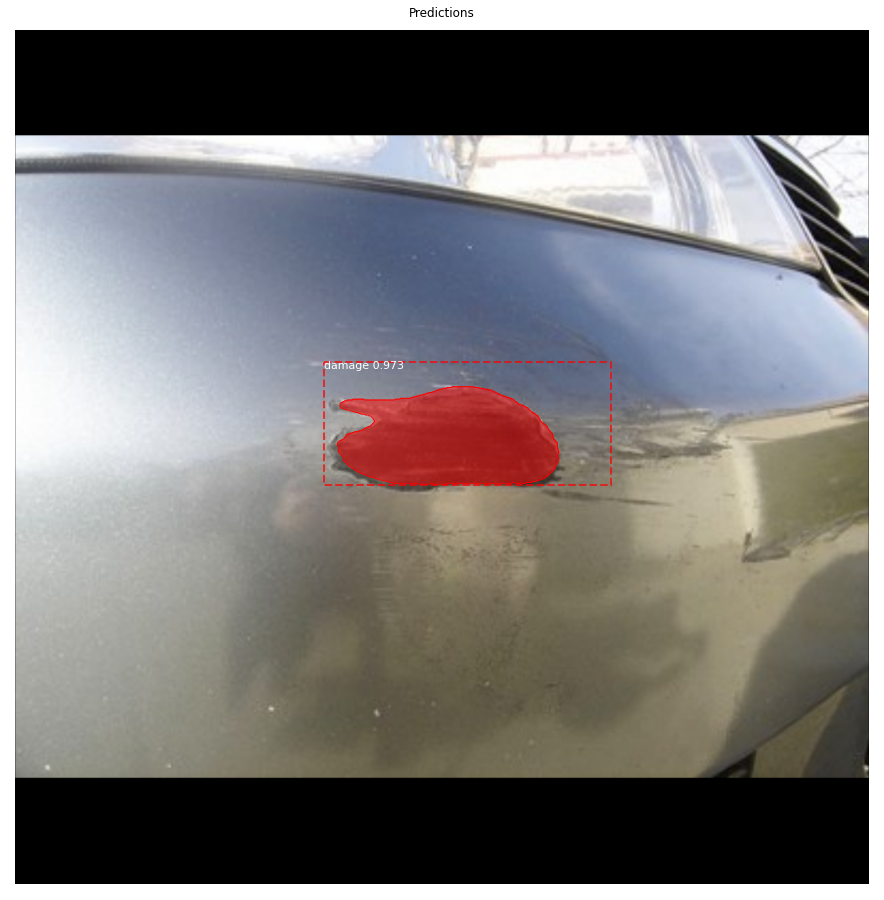

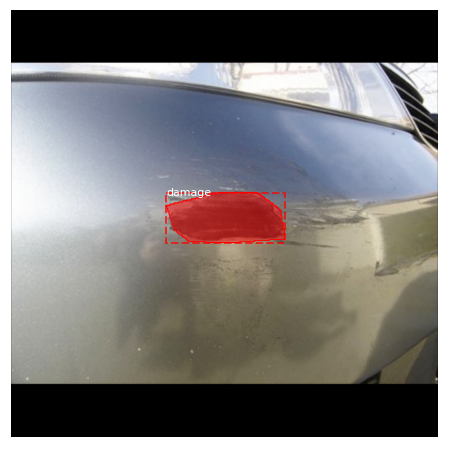

1
image ID: damage.car11.png (4) C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\customImages\val\car11.png
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (3,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (3, 4)                min:  174.00000  max:  717.00000  int32
gt_mask                  shape: (1024, 1024, 3)       min:    0.00000  max:    1.00000  bool


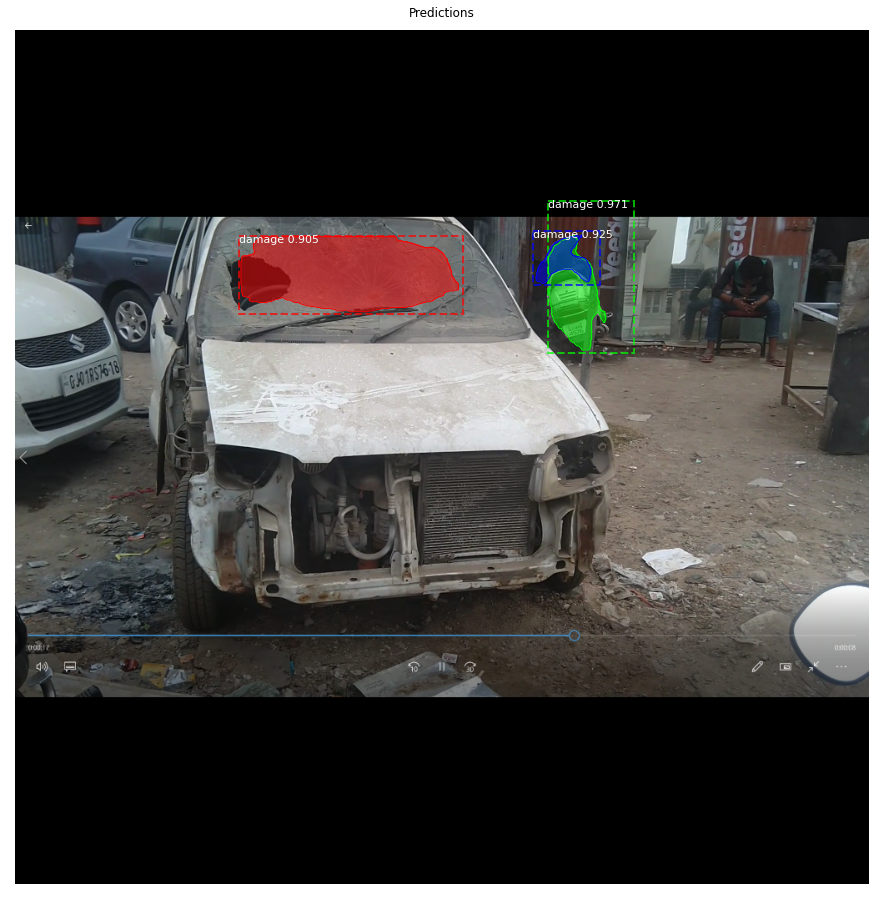

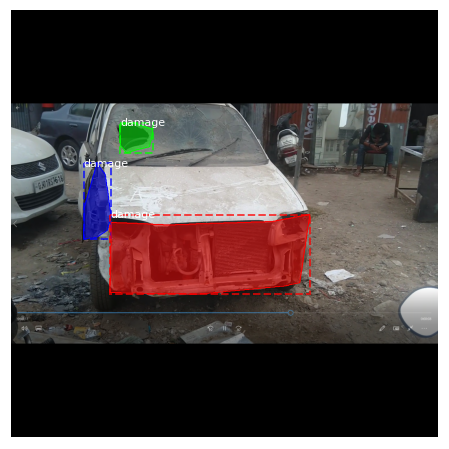

2
image ID: damage.car4.png (2) C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\customImages\val\car4.png
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (2,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (2, 4)                min:   56.00000  max:  883.00000  int32
gt_mask                  shape: (1024, 1024, 2)       min:    0.00000  max:    1.00000  bool


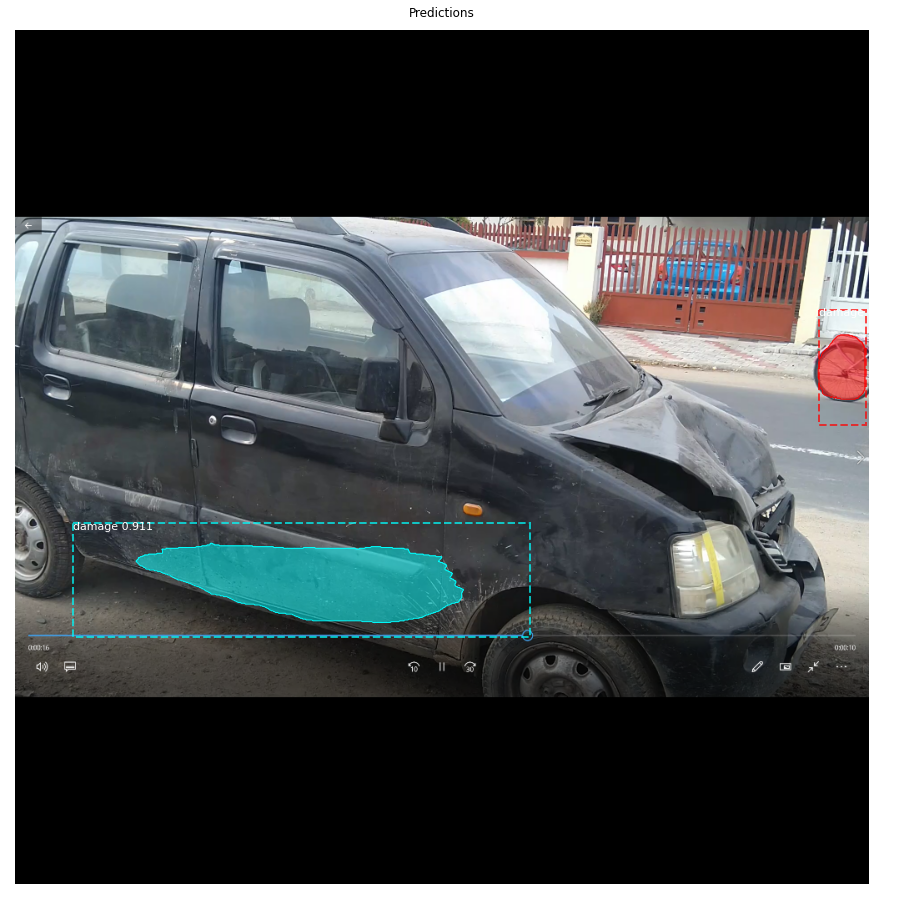

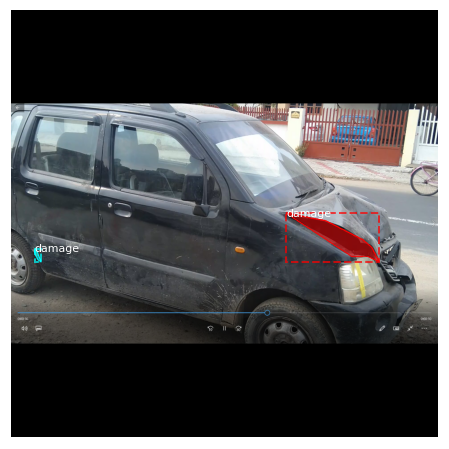

3
image ID: damage.car2.png (0) C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\customImages\val\car2.png
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (7,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (7, 4)                min:  138.00000  max:  717.00000  int32
gt_mask                  shape: (1024, 1024, 7)       min:    0.00000  max:    1.00000  bool


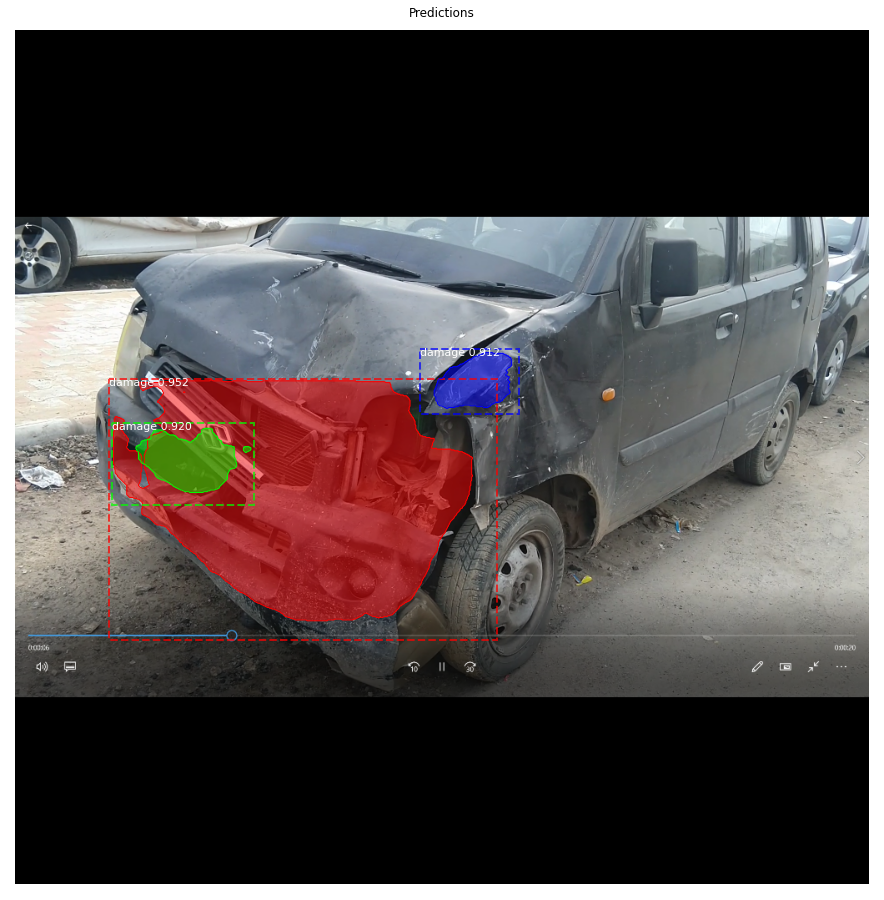

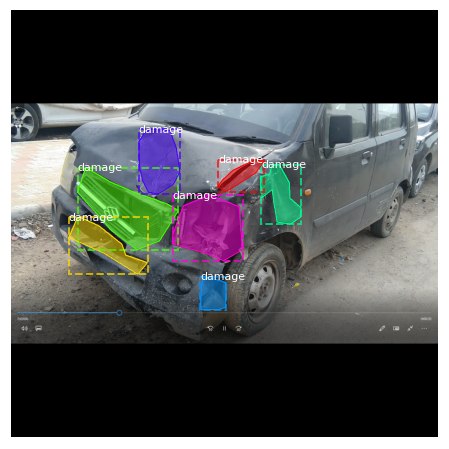

4
image ID: damage.image64.jpg (9) C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\customImages\val\image64.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (2,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (2, 4)                min:  344.00000  max:  670.00000  int32
gt_mask                  shape: (1024, 1024, 2)       min:    0.00000  max:    1.00000  bool


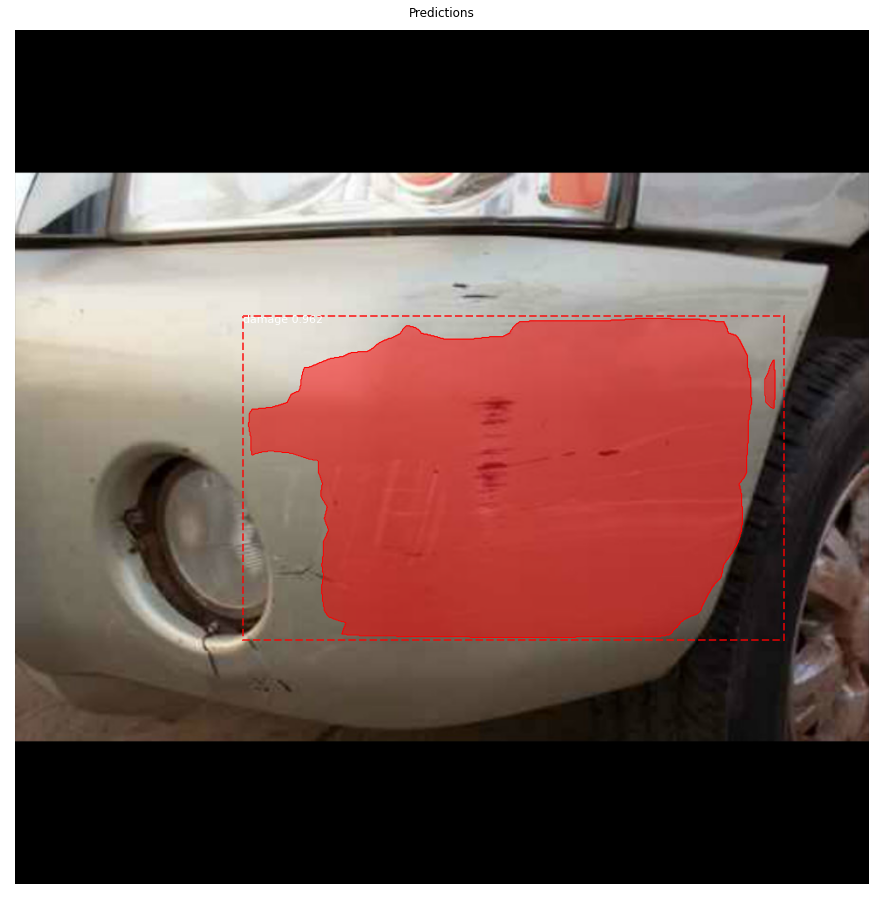

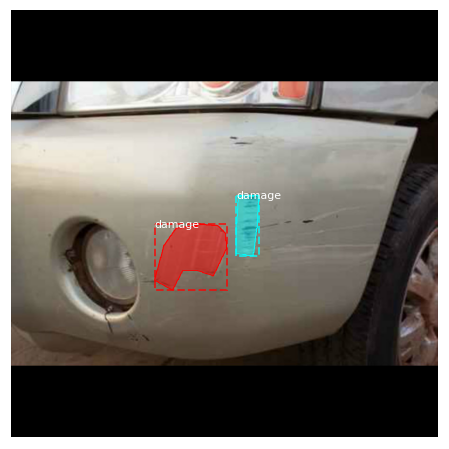

5
image ID: damage.car2.png (0) C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\customImages\val\car2.png
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (7,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (7, 4)                min:  138.00000  max:  717.00000  int32
gt_mask                  shape: (1024, 1024, 7)       min:    0.00000  max:    1.00000  bool


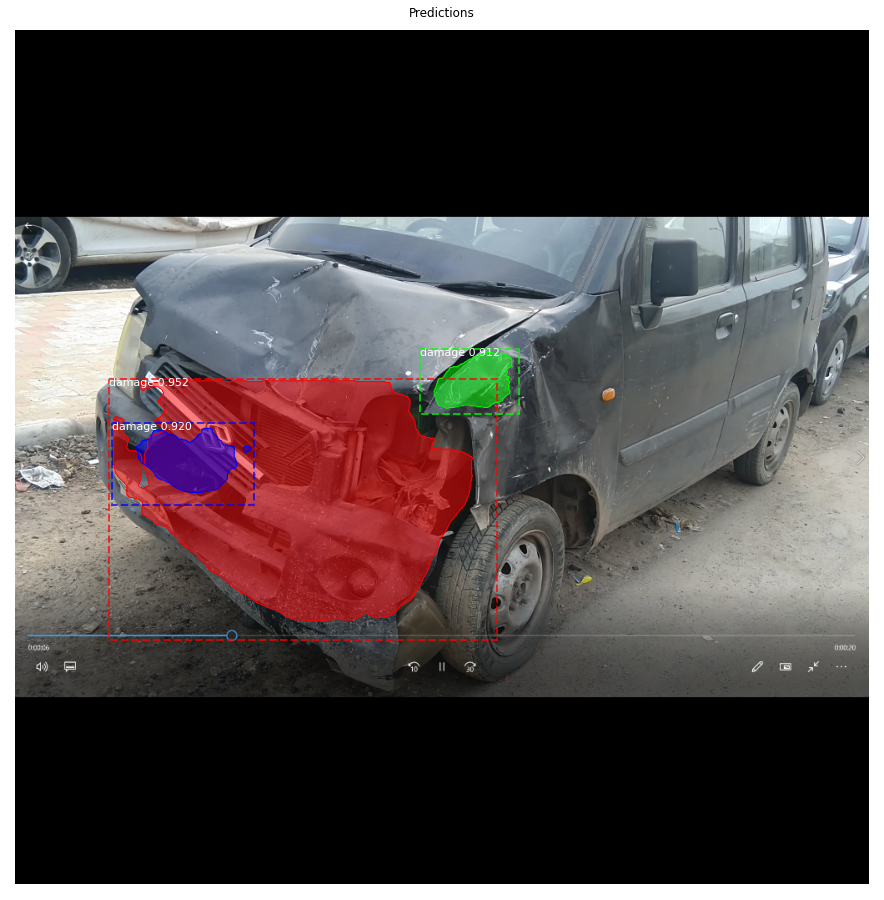

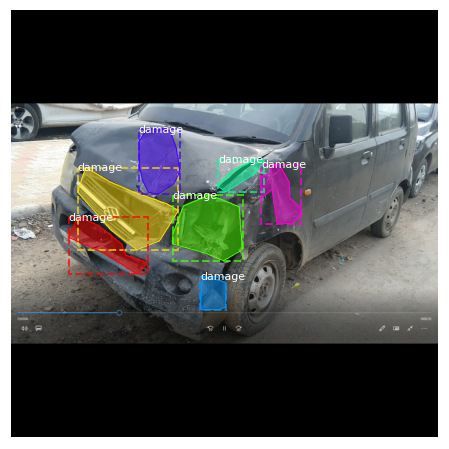

6
image ID: damage.car11.png (4) C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\customImages\val\car11.png
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (3,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (3, 4)                min:  174.00000  max:  717.00000  int32
gt_mask                  shape: (1024, 1024, 3)       min:    0.00000  max:    1.00000  bool


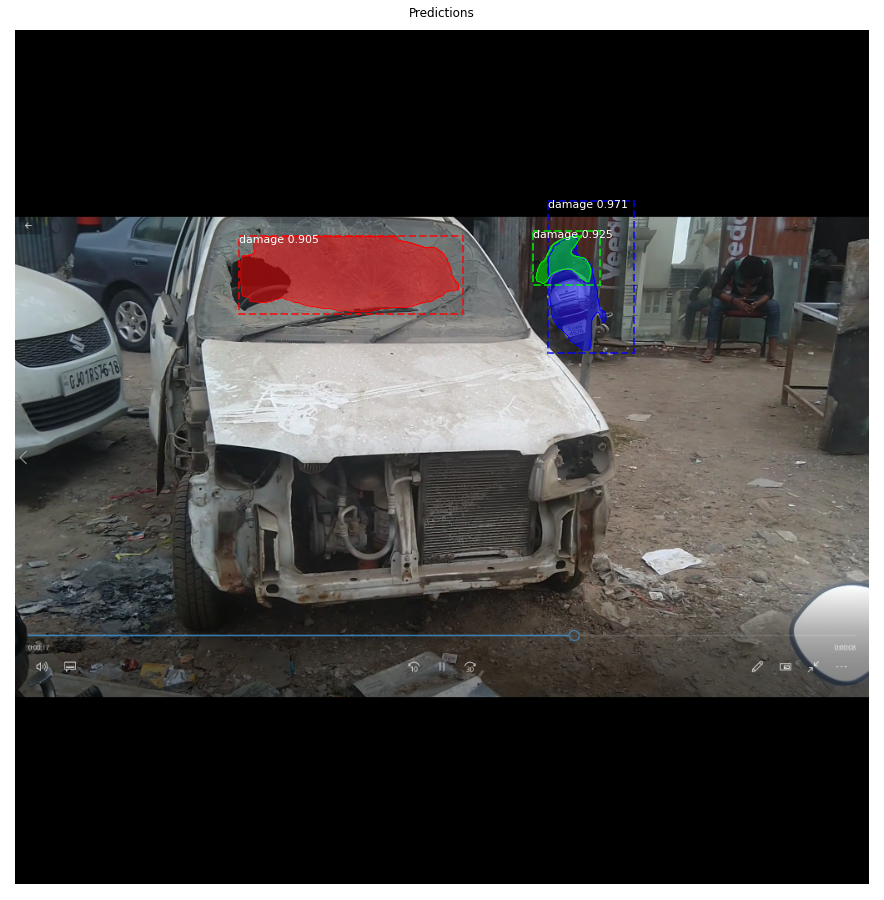

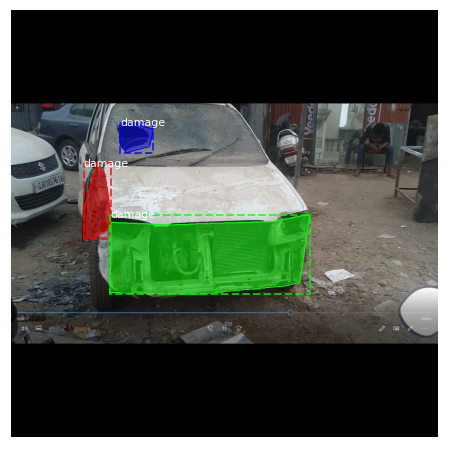

7
image ID: damage.image62.jpg (7) C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\customImages\val\image62.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (2,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (2, 4)                min:  108.00000  max:  707.00000  int32
gt_mask                  shape: (1024, 1024, 2)       min:    0.00000  max:    1.00000  bool


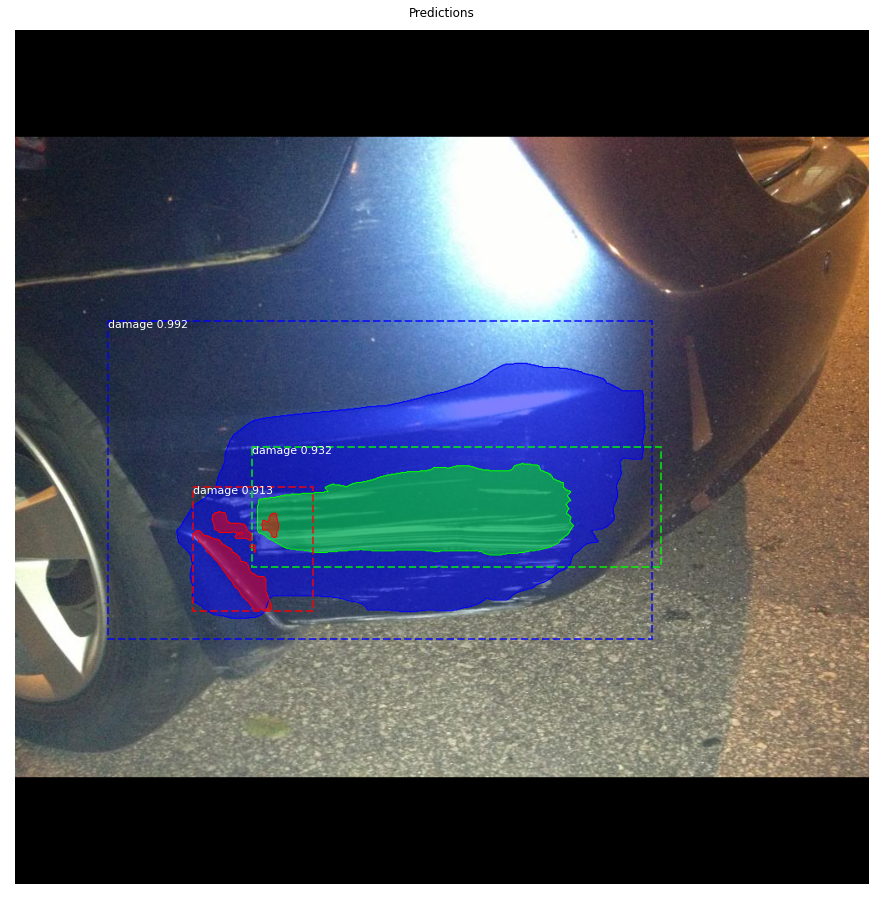

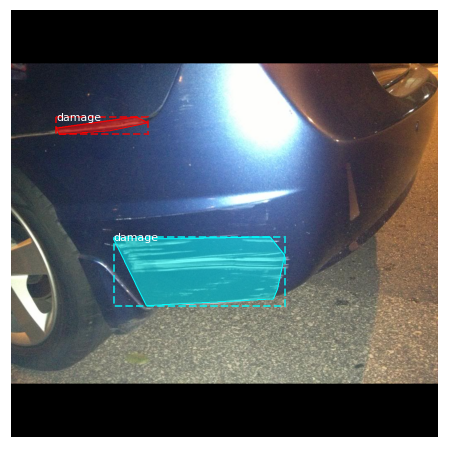

8
image ID: damage.image75.jpg (15) C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\customImages\val\image75.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  254.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  150.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32

*** No instances to display *** 

gt_class_id              shape: (2,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (2, 4)                min:  405.00000  max:  966.00000  int32
gt_mask                  shape: (1024, 1024, 2)       min:    0.00000  max:    1.00000  bool


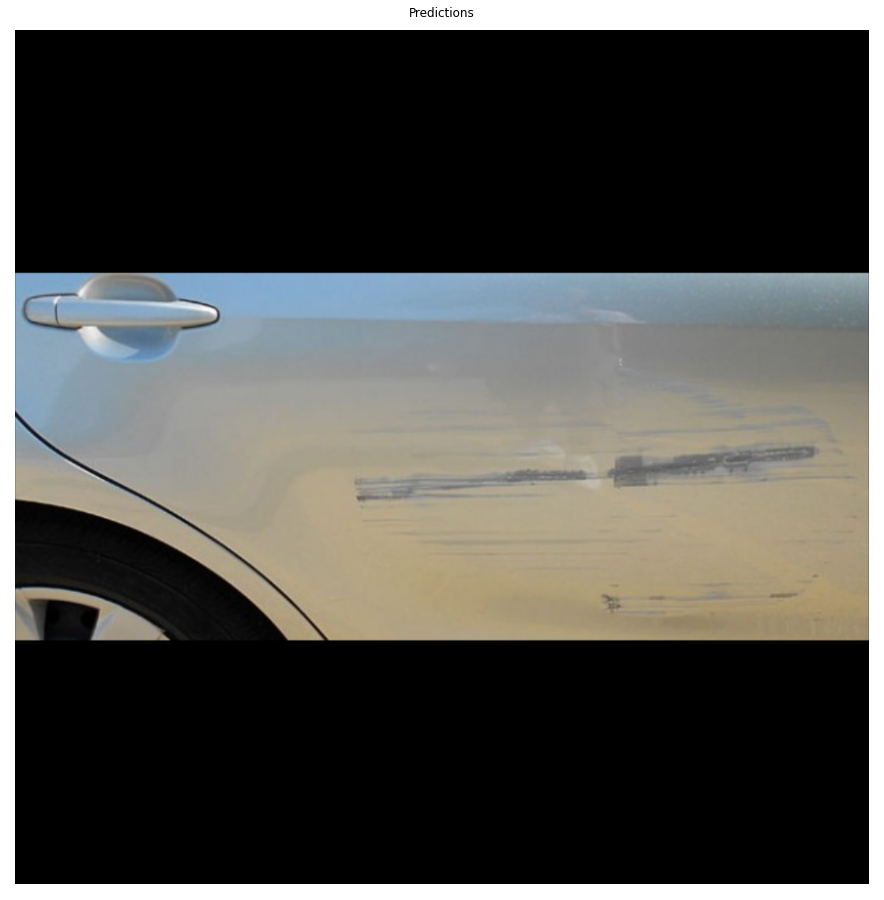

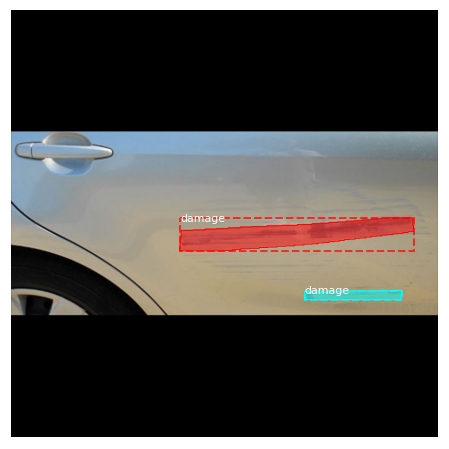

9
image ID: damage.image78.jpg (18) C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\customImages\val\image78.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:  164.00000  max:  708.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool


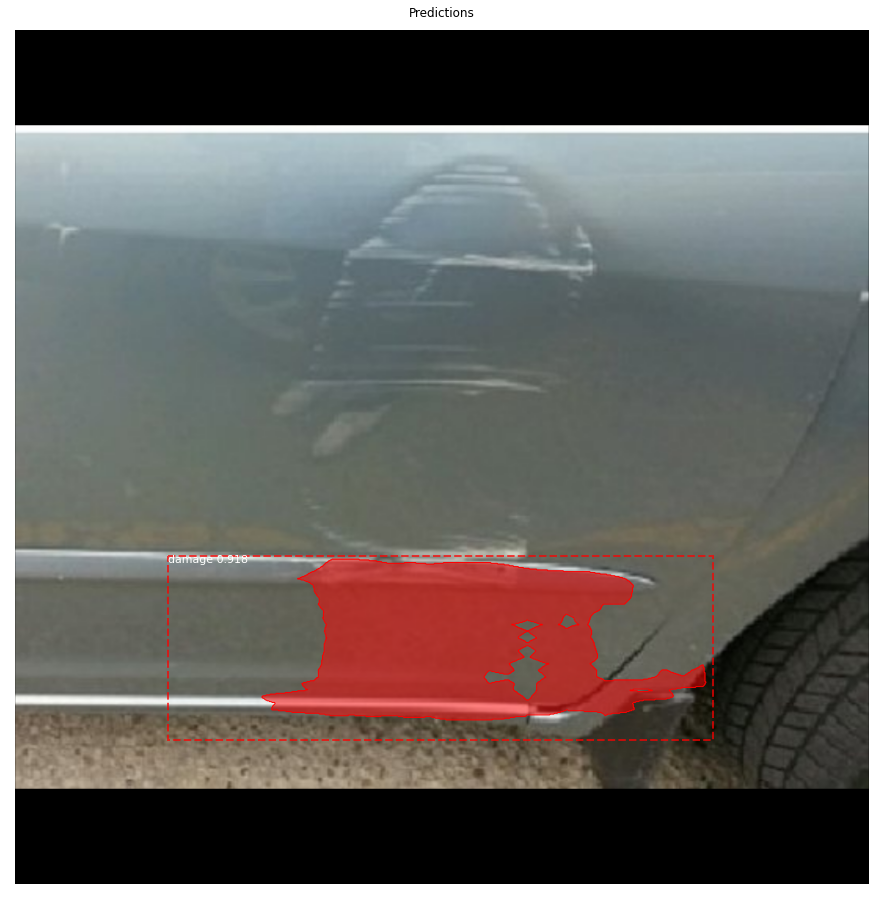

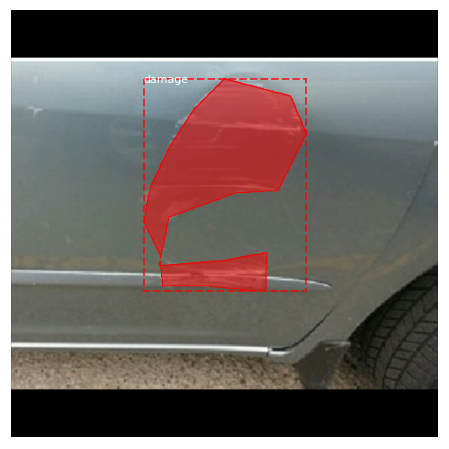

10
image ID: damage.car4.png (2) C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\customImages\val\car4.png
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (2,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (2, 4)                min:   56.00000  max:  883.00000  int32
gt_mask                  shape: (1024, 1024, 2)       min:    0.00000  max:    1.00000  bool


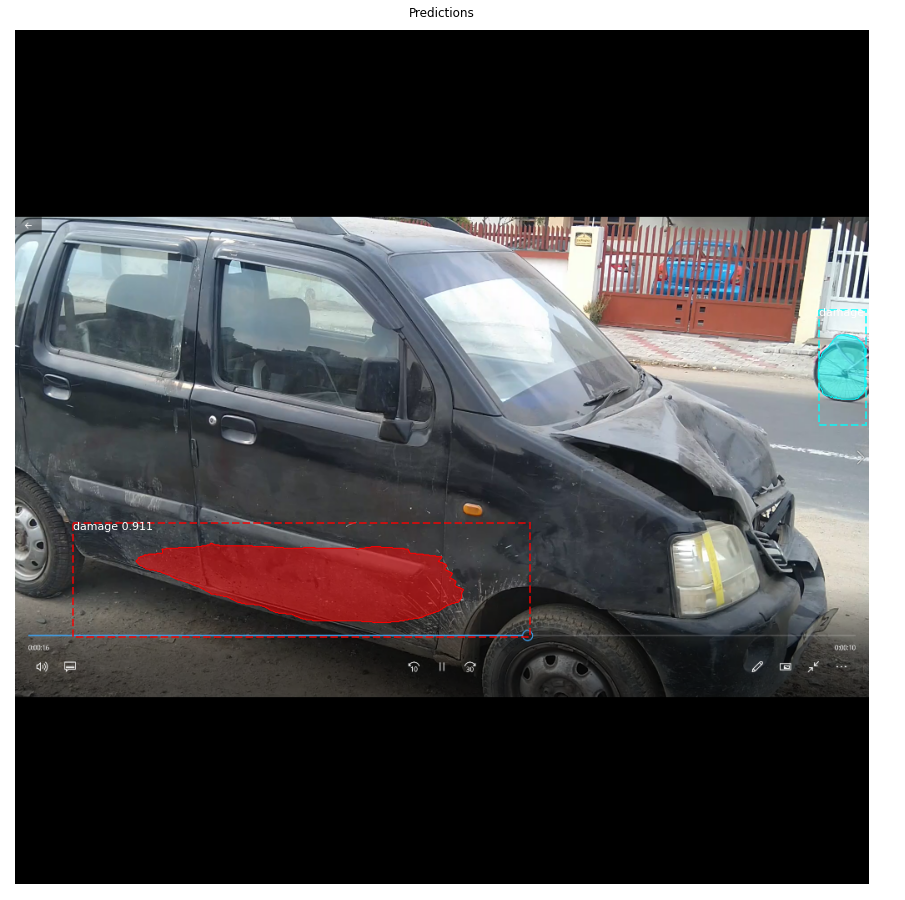

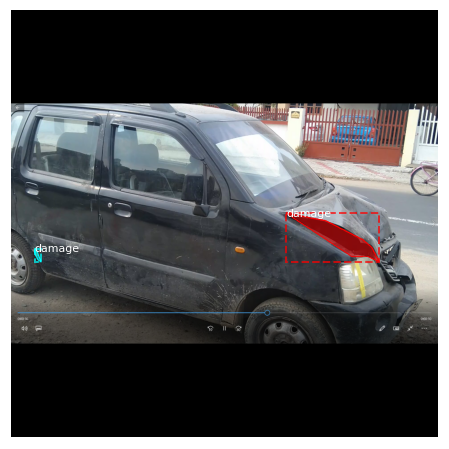

11
image ID: damage.image79.jpg (19) C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\customImages\val\image79.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:  371.00000  max:  656.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool


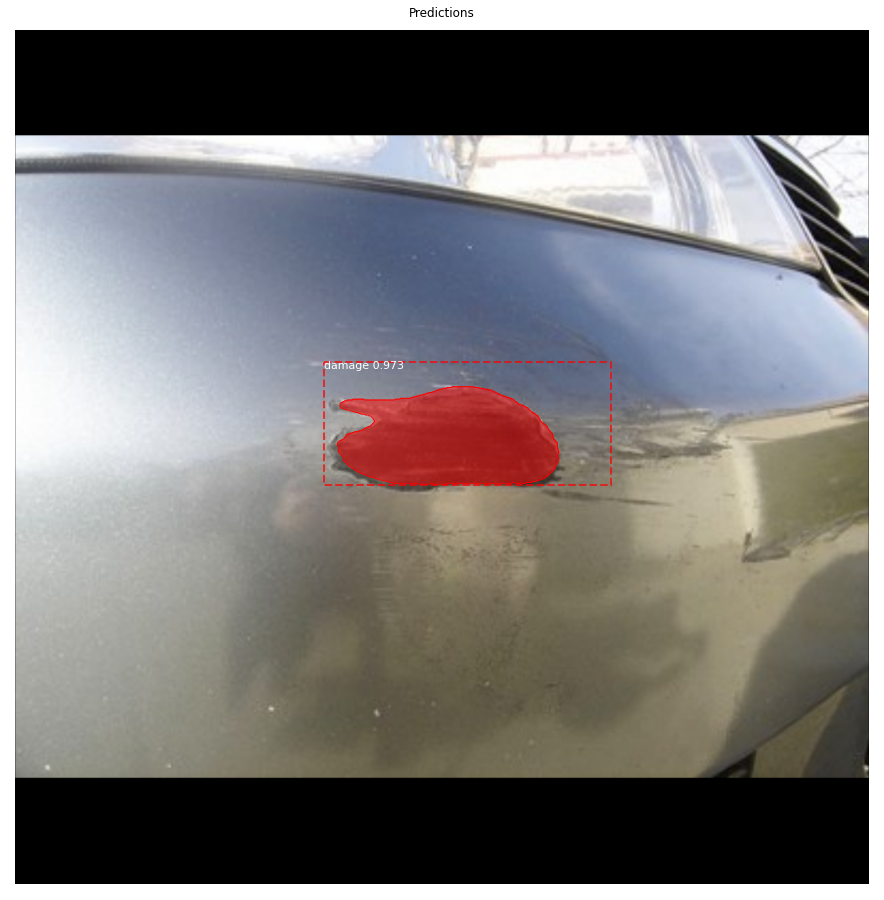

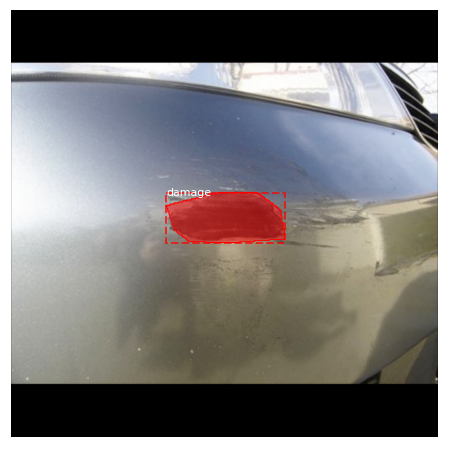

12
image ID: damage.car4.png (2) C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\customImages\val\car4.png
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (2,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (2, 4)                min:   56.00000  max:  883.00000  int32
gt_mask                  shape: (1024, 1024, 2)       min:    0.00000  max:    1.00000  bool


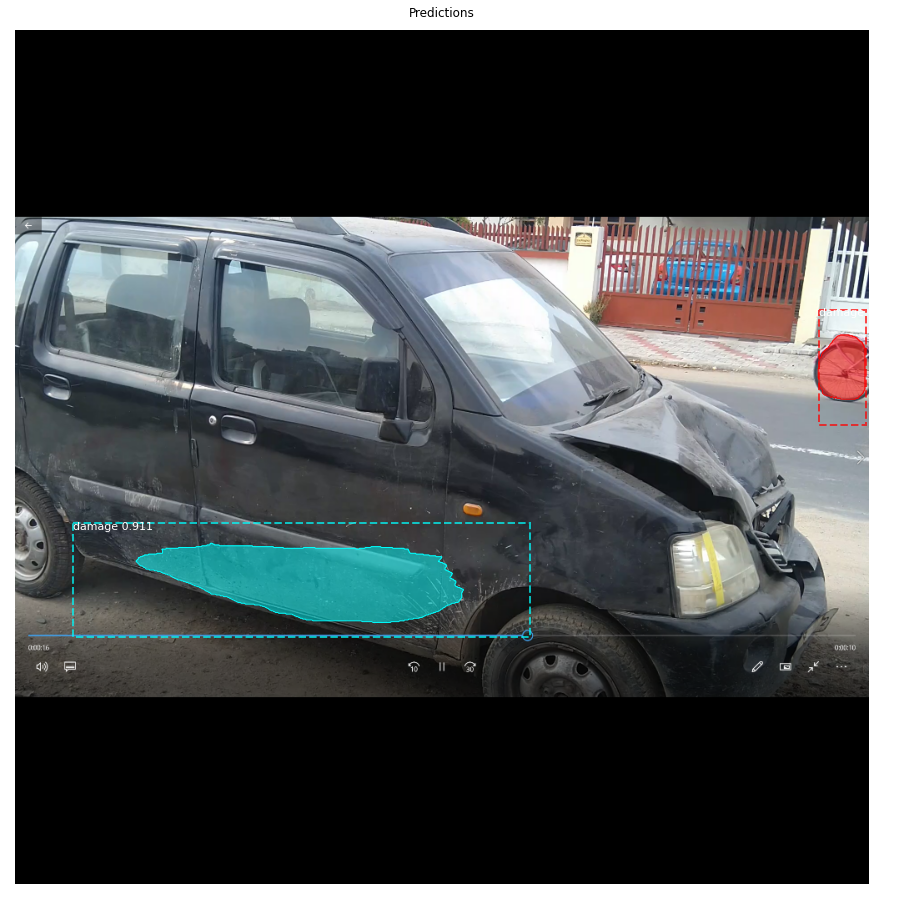

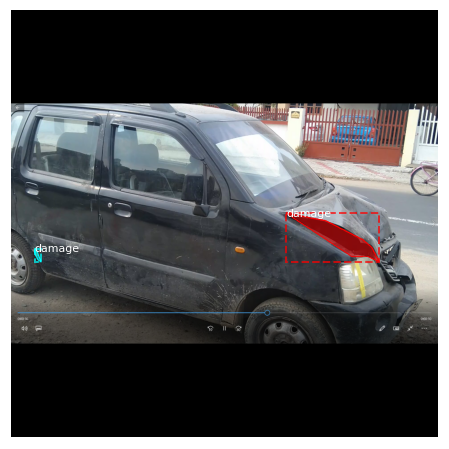

13
image ID: damage.image76.jpg (16) C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\customImages\val\image76.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (2,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (2, 4)                min:  380.00000  max:  891.00000  int32
gt_mask                  shape: (1024, 1024, 2)       min:    0.00000  max:    1.00000  bool


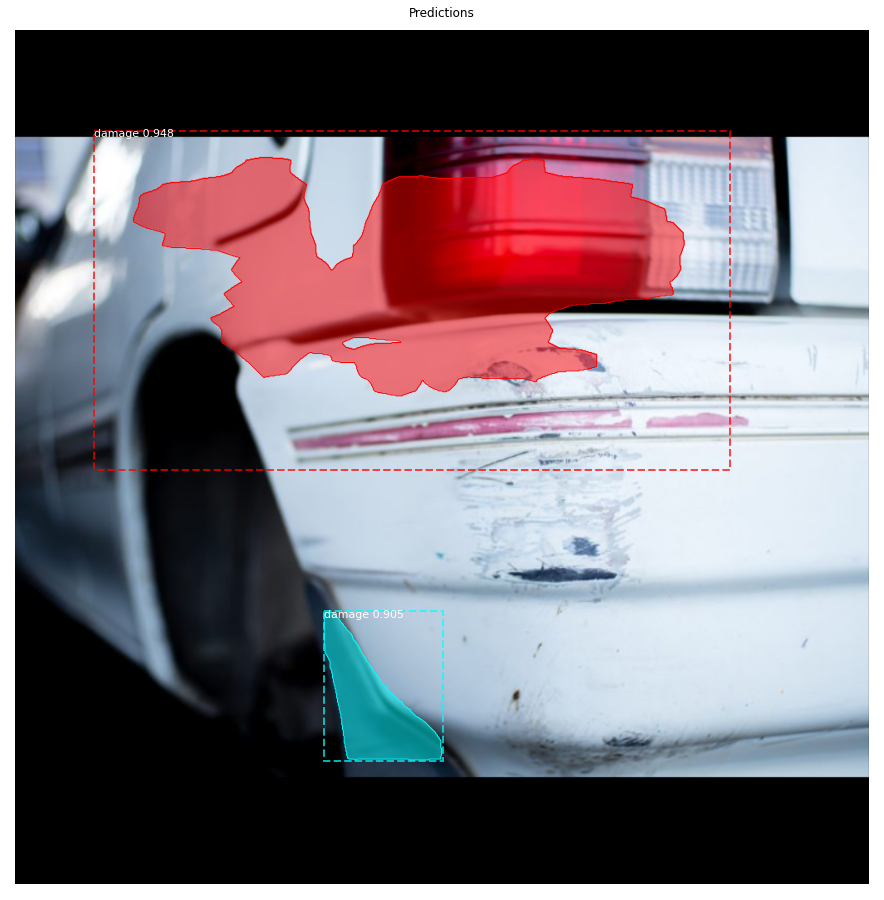

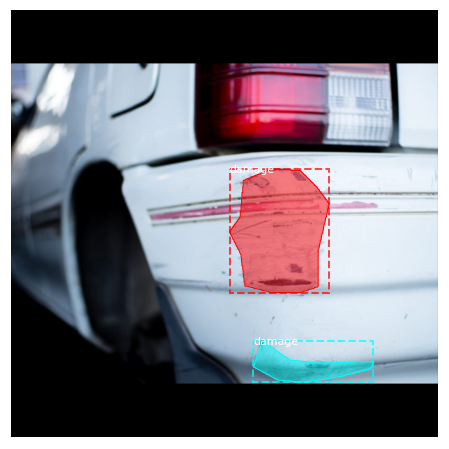

14
image ID: damage.image74.jpeg (13) C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\customImages\val\image74.jpeg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:  155.00000  max:  961.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool


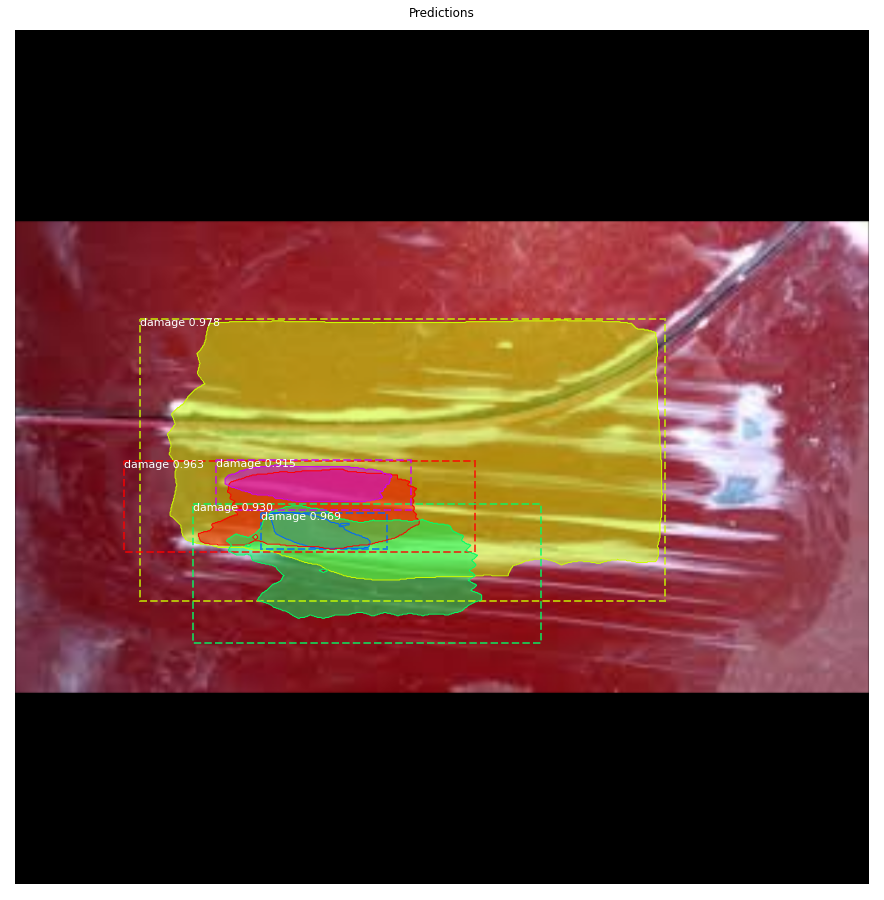

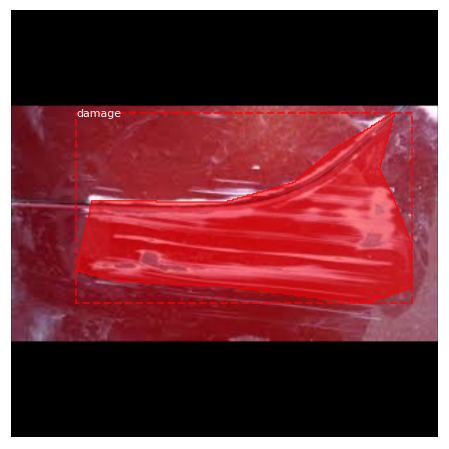

15
image ID: damage.car3.png (1) C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\customImages\val\car3.png
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (3,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (3, 4)                min:  243.00000  max:  851.00000  int32
gt_mask                  shape: (1024, 1024, 3)       min:    0.00000  max:    1.00000  bool


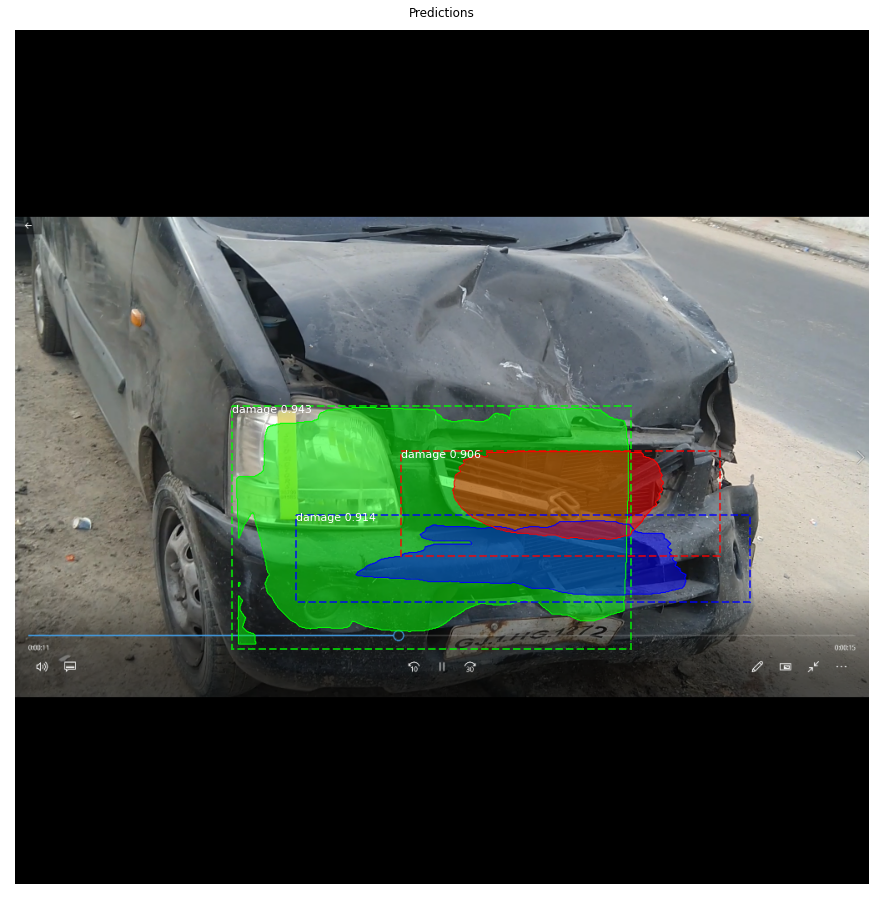

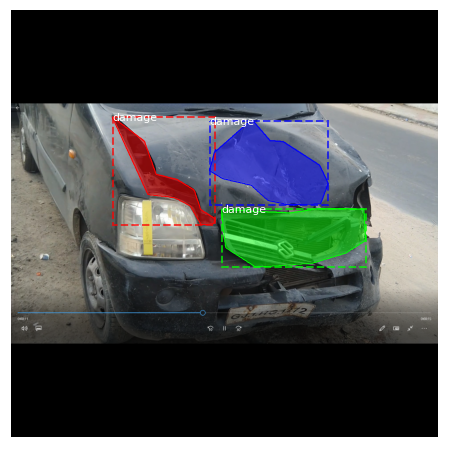

16
image ID: damage.car11.png (4) C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\customImages\val\car11.png
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (3,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (3, 4)                min:  174.00000  max:  717.00000  int32
gt_mask                  shape: (1024, 1024, 3)       min:    0.00000  max:    1.00000  bool


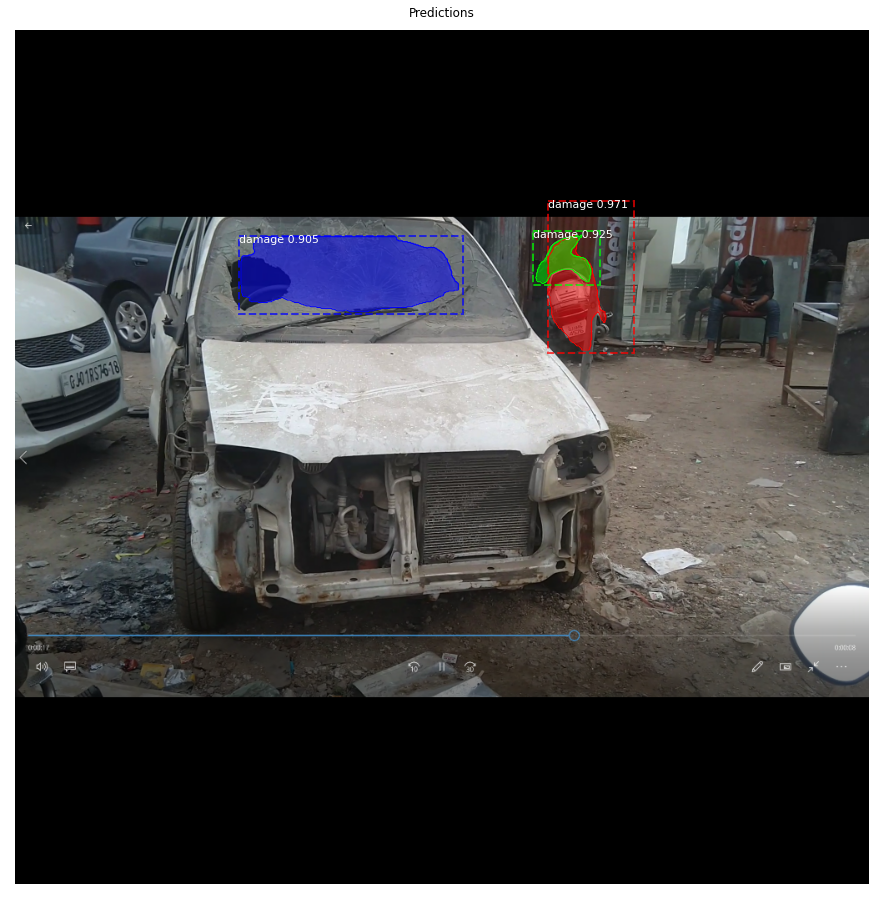

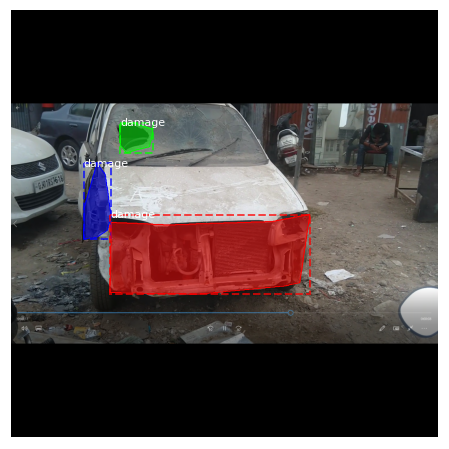

17
image ID: damage.car12.png (5) C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\customImages\val\car12.png
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (3,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (3, 4)                min:  264.00000  max:  826.00000  int32
gt_mask                  shape: (1024, 1024, 3)       min:    0.00000  max:    1.00000  bool


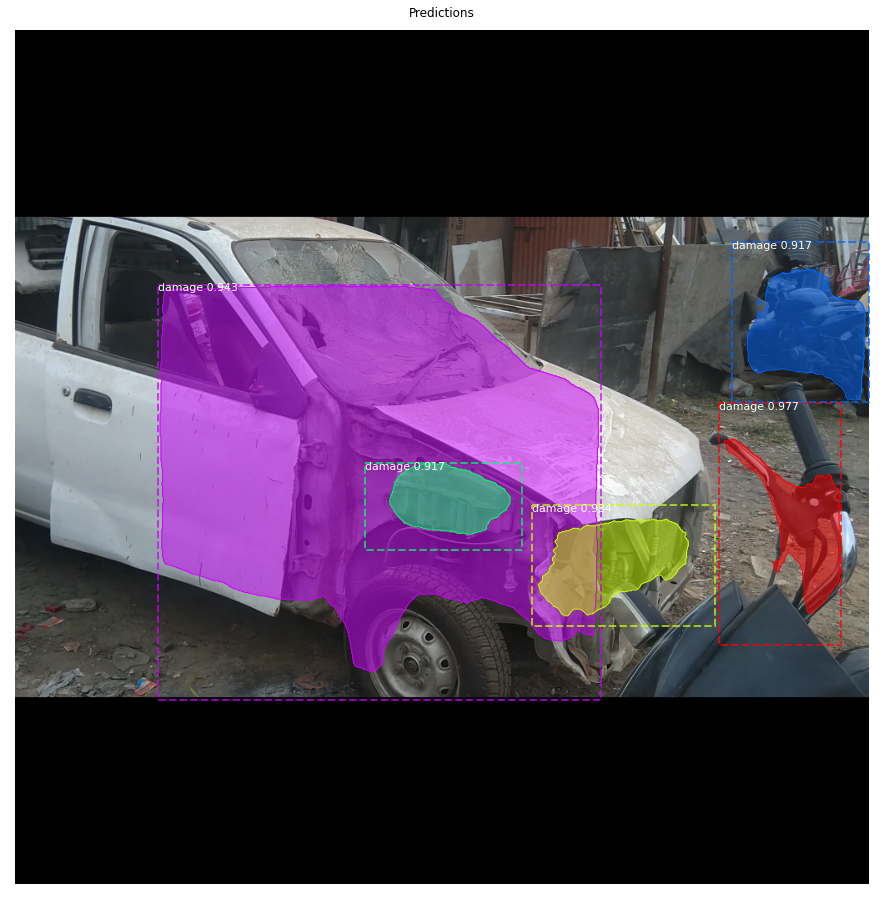

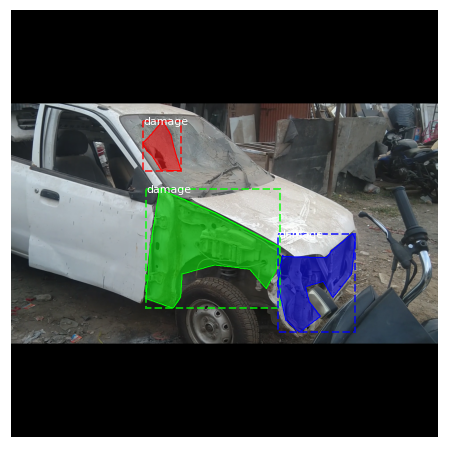

18
image ID: damage.image62.jpg (7) C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\customImages\val\image62.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (2,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (2, 4)                min:  108.00000  max:  707.00000  int32
gt_mask                  shape: (1024, 1024, 2)       min:    0.00000  max:    1.00000  bool


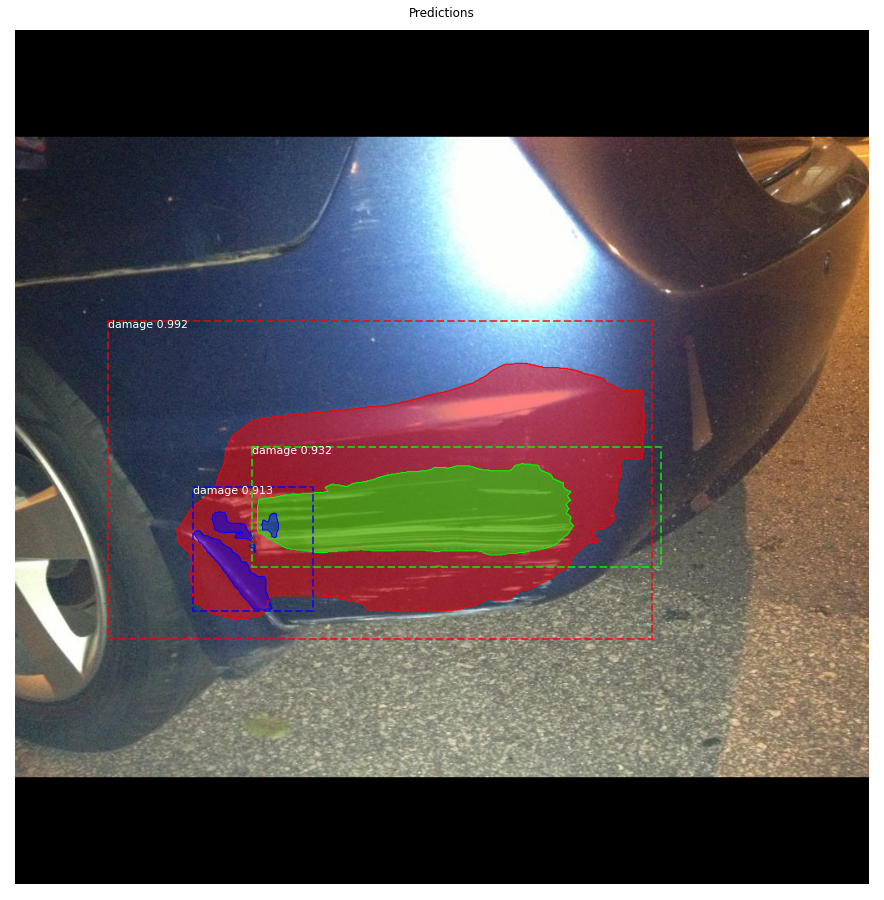

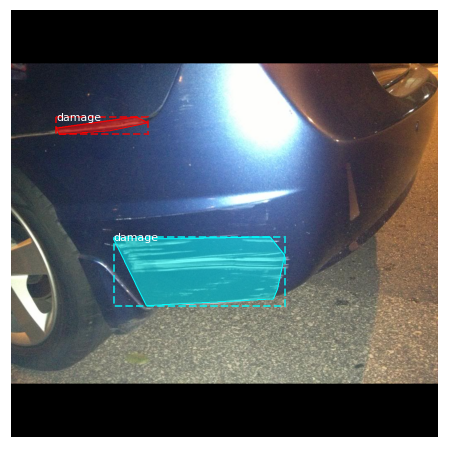

19
image ID: damage.image77.jpg (17) C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\customImages\val\image77.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (2,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (2, 4)                min:  302.00000  max:  529.00000  int32
gt_mask                  shape: (1024, 1024, 2)       min:    0.00000  max:    1.00000  bool


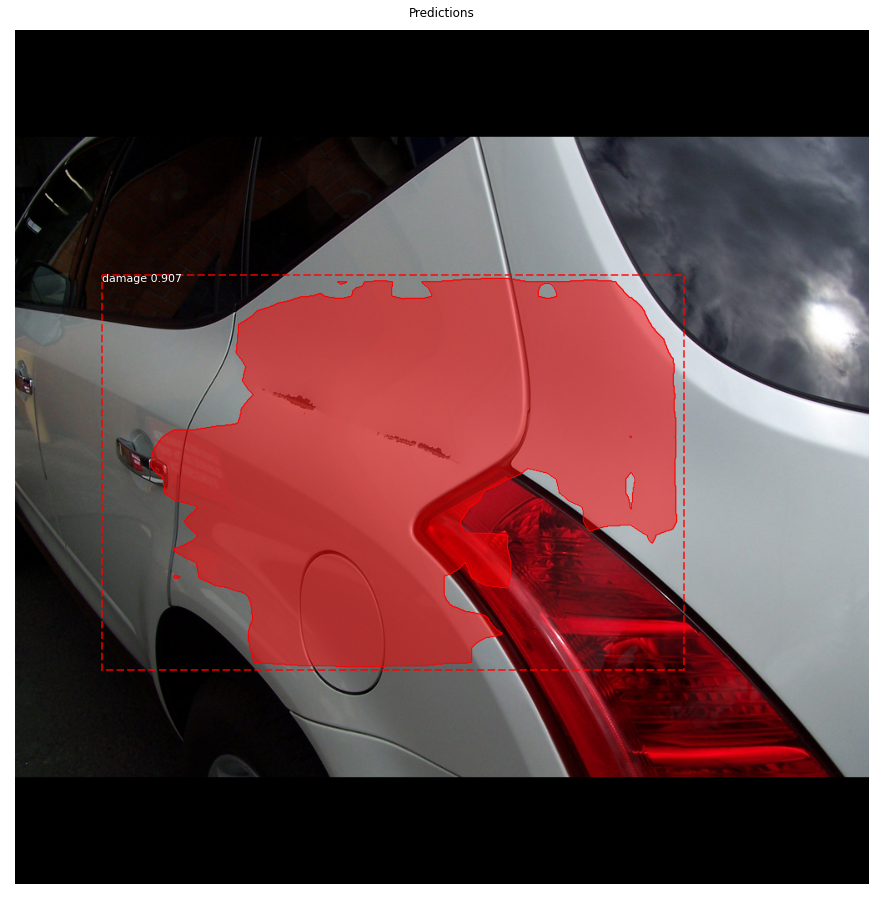

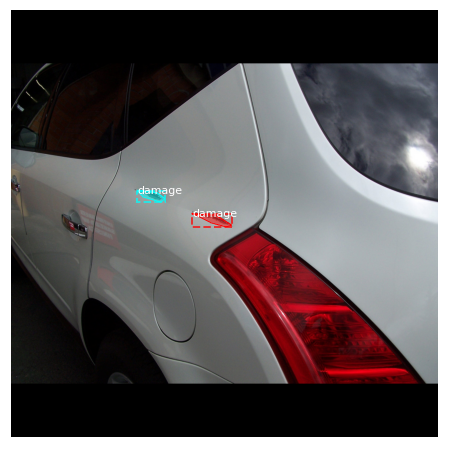

20
image ID: damage.image63.jpg (8) C:\Users\s.gopisundaran.nair\Desktop\Machine Learning\Mask_RCNN-master\customImages\val\image63.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:  311.00000  max:  802.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool


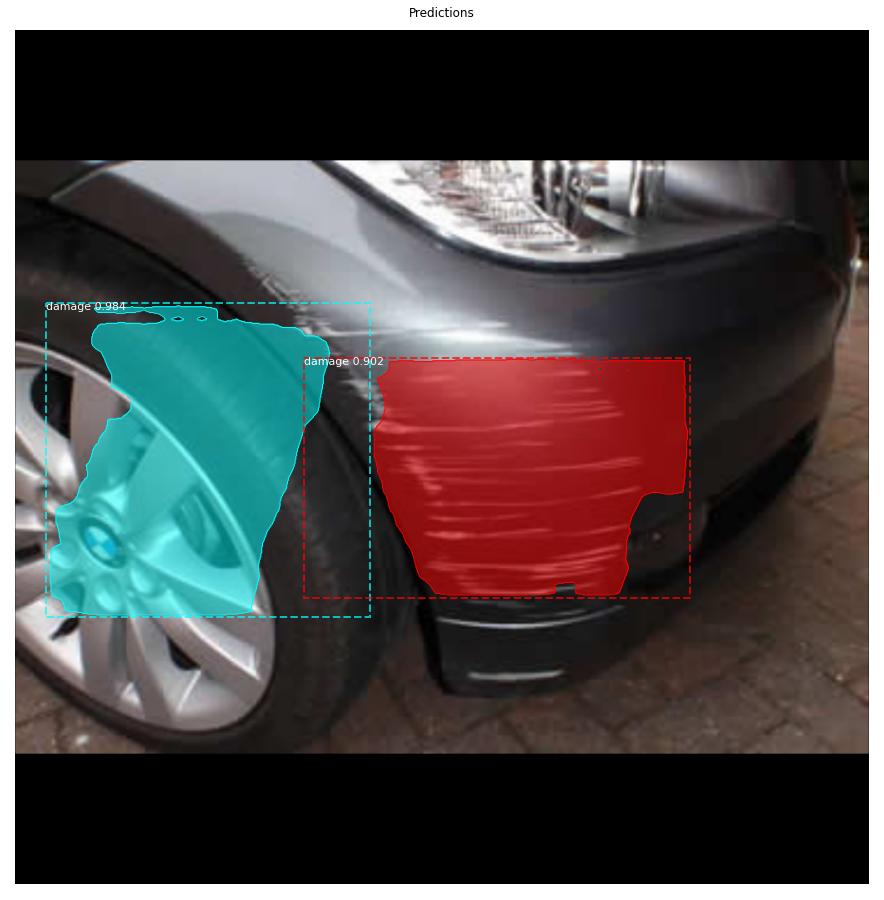

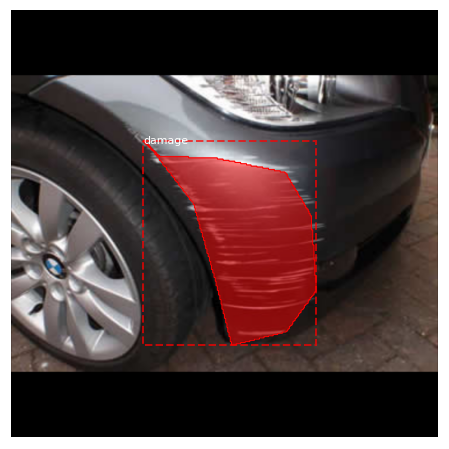

In [16]:

print(dataset_val.image_ids)
for i in dataset_val.image_ids:
    print(i)
    image_id = random.choice(dataset_val.image_ids)
    original_image, image_meta, gt_class_id, gt_bbox, gt_mask =\
        modellib.load_image_gt(dataset_val, config, image_id, use_mini_mask=False)
    info = dataset_val.image_info[image_id]
    print("image ID: {}.{} ({}) {}".format(info["source"], info["id"], image_id, 
                                       dataset_val.image_reference(image_id)))

    # Run object detection
    results = model.detect([original_image], verbose=1)

    # Display results
    ax = get_ax(1)
    r = results[0]
    visualize.display_instances(original_image, r['rois'], r['masks'], r['class_ids'], 
                            dataset_val.class_names, r['scores'], ax=ax,
                            title="Predictions")
    log("gt_class_id", gt_class_id)
    log("gt_bbox", gt_bbox)
    log("gt_mask", gt_mask)

    visualize.display_instances(original_image, gt_bbox, gt_mask, gt_class_id, 
                            dataset_train.class_names, figsize=(8, 8))

Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


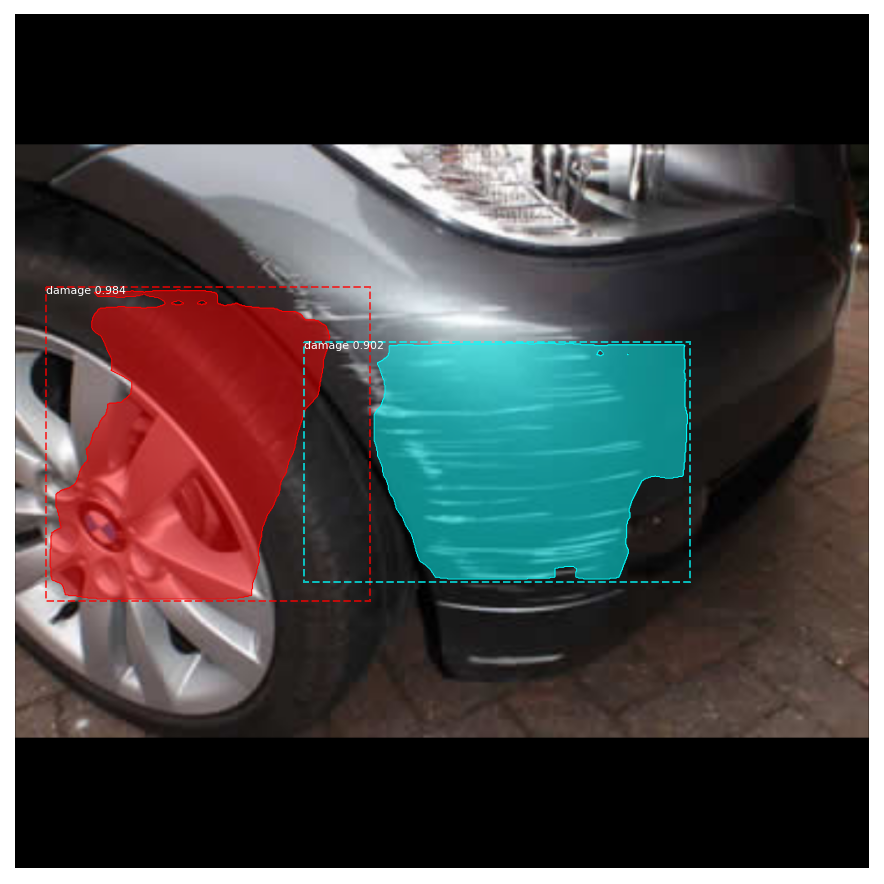

In [17]:
results = model.detect([original_image], verbose=1)

r = results[0]
visualize.display_instances(original_image, r['rois'], r['masks'], r['class_ids'], 
                            dataset_val.class_names, r['scores'], ax=get_ax())

## Evaluation

In [19]:
# Compute VOC-Style mAP @ IoU=0.5
# Running on 10 images. Increase for better accuracy.
image_ids = np.random.choice(dataset_val.image_ids, 10)
APs = []
for image_id in image_ids:
    # Load image and ground truth data
    image, image_meta, gt_class_id, gt_bbox, gt_mask =\
        modellib.load_image_gt(dataset_val, inference_config,
                               image_id, use_mini_mask=False)
    molded_images = np.expand_dims(modellib.mold_image(image, inference_config), 0)
    # Run object detection
    results = model.detect([image], verbose=0)
    r = results[0]
    # Compute AP
    AP, precisions, recalls, overlaps =\
        utils.compute_ap(gt_bbox, gt_class_id, gt_mask,
                         r["rois"], r["class_ids"], r["scores"], r['masks'])
    APs.append(AP)
    
print("mAP: ", np.mean(APs))

mAP:  0.113055555721124
